***TIMEIT get_all_data TOOK: 2.065 s
                          kWh     t_ref  n_jump  n_exec  p_max  p_mean  p_min
ts                                                                           
2016-09-24 09:00:00  0.263024  0.999838       0       0  382.0   263.0  217.0
2016-09-24 10:00:00  0.272466  1.000088       0       0  857.0   272.0  236.0
2016-09-24 11:00:00  0.263264  0.999959       0       0  319.0   263.0  231.0
2016-09-24 12:00:00  0.288171  0.999889       0       0  909.0   288.0  235.0
2016-09-24 13:00:00  0.238090  0.828952       0       0  374.0   287.0  240.0
       count  mean  std  min  25%  50%  75%  max
ldr  3585678   249  231   11   32  161  474  748
         count  mean  std  min  25%  50%  75%   max
power  3585678   343  315  112  225  265  358  5304


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1179db240>]], dtype=object)

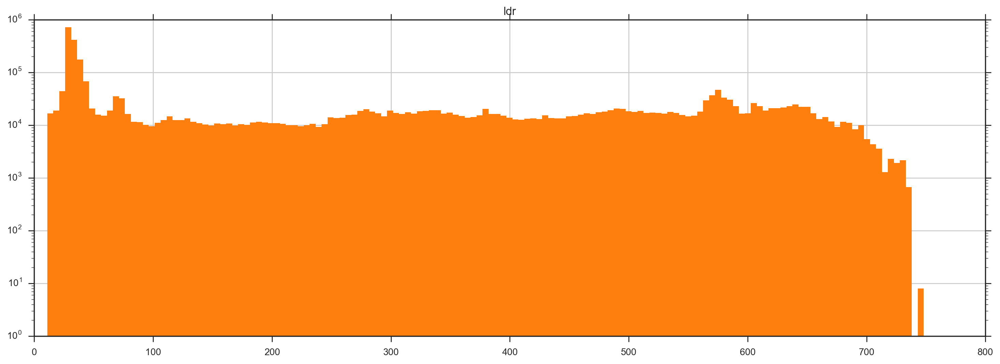

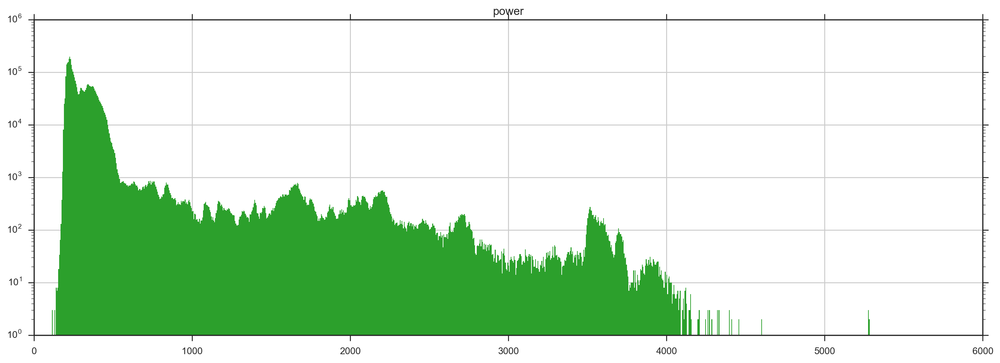

In [6]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
from IPython.display import Image, HTML

import random
import math
import pysolar
import datetime as dt
import pytz
import matplotlib.dates as mpd
import scipy
import scipy.signal as signal
import sklearn
import numexpr as ne

from datacharm import *
from datacharm.dataplots import tableau20, ch_color

from enerpi.base import timeit
from enerpi.api import enerpi_data_catalog
from enerpi.enerplot import plot_tile_last_24h, plot_power_consumption_hourly
from enerpi.sunposition import sun_position


LAT = 38.631463
LONG = -0.866402
ELEV_M = 500
TZ = pytz.timezone('Europe/Madrid')
FS = (16, 10)
sns.set_style('ticks')
pd.set_option('display.width', 120)


def _tslim(ax, h0=12, hf=22, m0=0, mf=0):
    xlim = [mpd.num2date(x, tz=TZ) for x in ax.get_xlim()]
    new = [mpd.date2num(d.replace(hour=h, minute=m)) for d, h, m in zip(xlim, [h0, hf], [m0, mf])]
    ax.set_xlim(new)
    return ax



# Catálogo y lectura de todos los datos.
cat = enerpi_data_catalog()
data, data_s = cat.get_all_data()
print_info(data_s.tail())

LDR = pd.DataFrame(data.ldr).tz_localize(TZ)
print_cyan(LDR.describe().T.astype(int))
LDR.hist(bins=(LDR.max() - LDR.min() + 1).values[0] // 5, log=True, figsize=(18, 6), lw=0, color=tableau20[2])
plt.plot()

POWER = pd.DataFrame(data.power).tz_localize(TZ)
print_cyan(POWER.describe().T.astype(int))
POWER.hist(bins=int((POWER.max() - POWER.min() + 1).values[0] // 5), log=True, figsize=(18, 6), lw=0, color=tableau20[4])

/Users/uge/anaconda/envs/py35/lib/python3.5/site-packages/statsmodels/nonparametric/kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


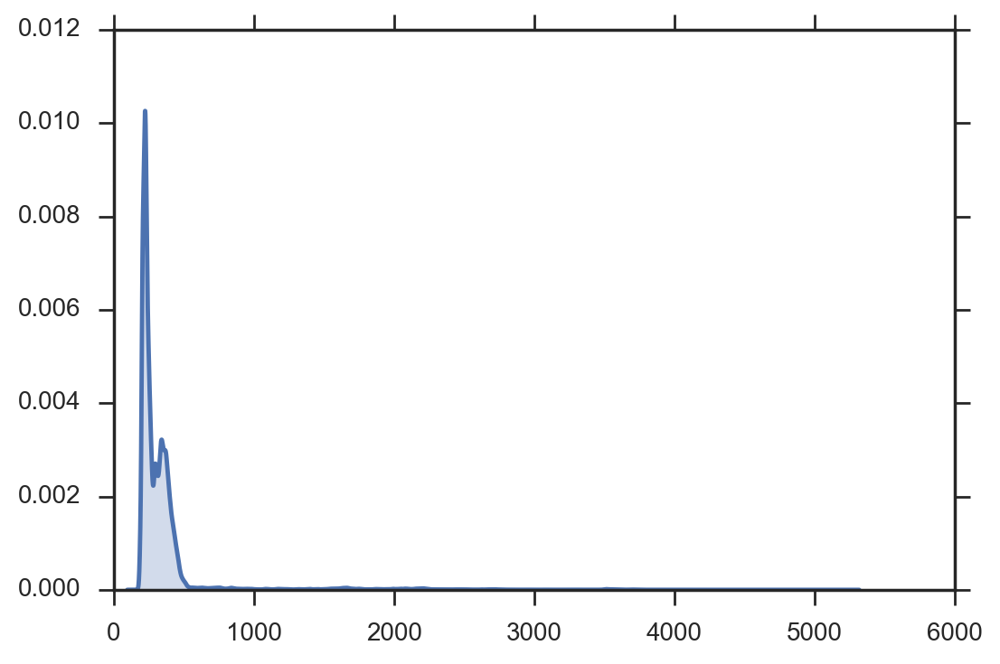

In [1126]:
sns.kdeplot(POWER.power.values, shade=True, gridsize=6000)

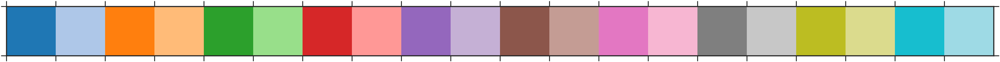

In [5]:
sns.palplot(tableau20)

In [34]:
homog_power = POWER.resample('1s').mean().fillna(method='bfill', limit=3).fillna(-1) #.round().astype('int16')
homog_power.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3726199 entries, 2016-08-12 10:46:25+02:00 to 2016-09-24 13:49:43+02:00
Freq: S
Data columns (total 1 columns):
power    float32
dtypes: float32(1)
memory usage: 42.6 MB


In [1268]:
POWER.power.round().value_counts()

225.0     40082
226.0     39897
227.0     39706
224.0     39609
223.0     39010
228.0     38825
222.0     38525
221.0     37295
229.0     37273
220.0     36522
230.0     35738
219.0     35256
218.0     34276
231.0     33899
217.0     32920
232.0     32222
216.0     31744
215.0     30570
233.0     30537
207.0     30457
208.0     30284
209.0     30049
214.0     30032
206.0     29996
210.0     29921
211.0     29740
213.0     29729
212.0     29493
234.0     29071
205.0     28588
          ...  
4065.0        1
4066.0        1
4069.0        1
4070.0        1
4072.0        1
4076.0        1
4083.0        1
4022.0        1
4019.0        1
4018.0        1
3972.0        1
3862.0        1
3865.0        1
3885.0        1
3893.0        1
3902.0        1
3928.0        1
3954.0        1
3963.0        1
3983.0        1
4016.0        1
3988.0        1
3995.0        1
3997.0        1
3999.0        1
4004.0        1
4005.0        1
4007.0        1
4012.0        1
112.0         1
Name: power, dtype: int6

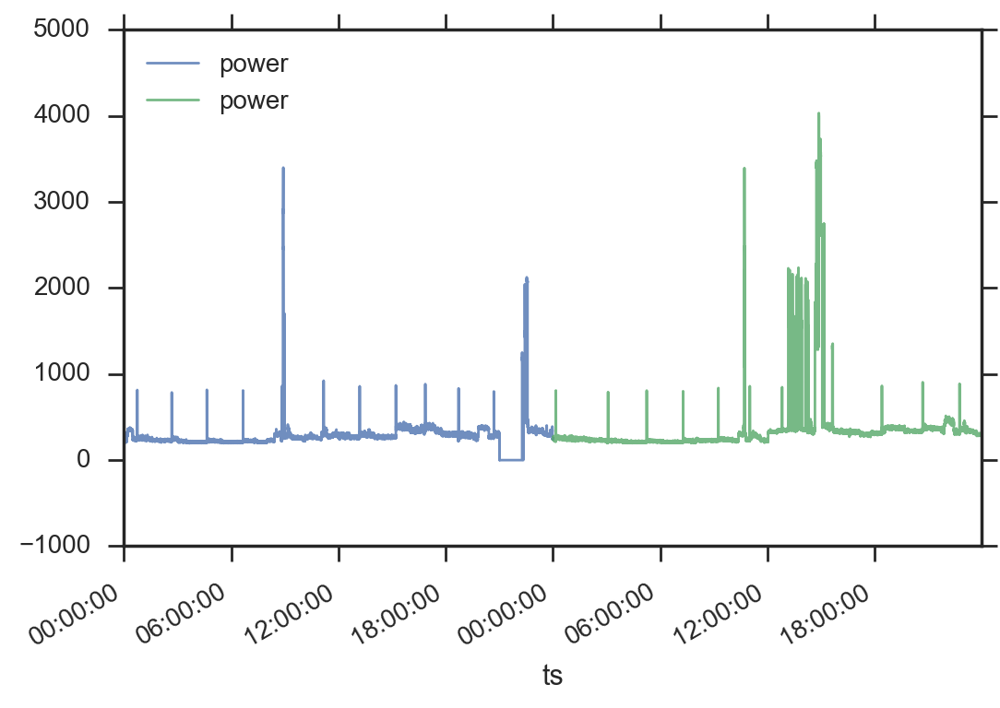

In [41]:
power_day13 = homog_power.loc['2016-08-13']
ax = power_day13.plot(lw=1, alpha=.8)

power_day14 = homog_power.loc['2016-08-14']
power_day14.plot(ax=ax, lw=1, alpha=.8)

In [30]:
power_day13.resample('1s').mean().fillna(method='bfill', limit=3).fillna(-1).round().astype(int)

power    5242
dtype: int64

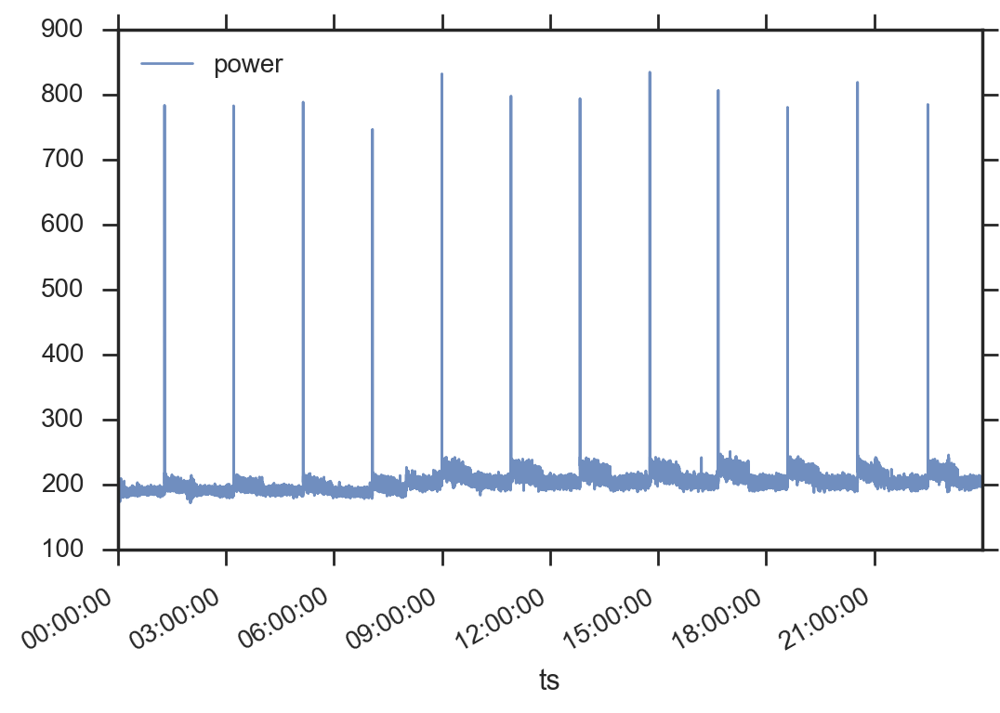

In [42]:
power_standby = homog_power.loc['2016-08-29']
power_standby.plot(lw=1, alpha=.8)

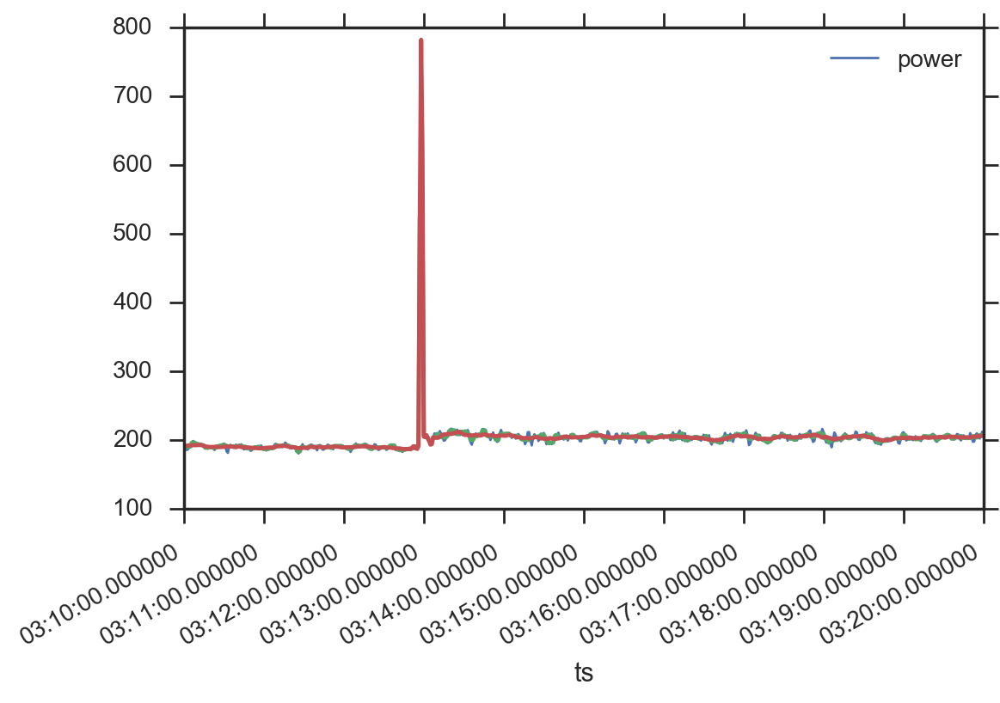

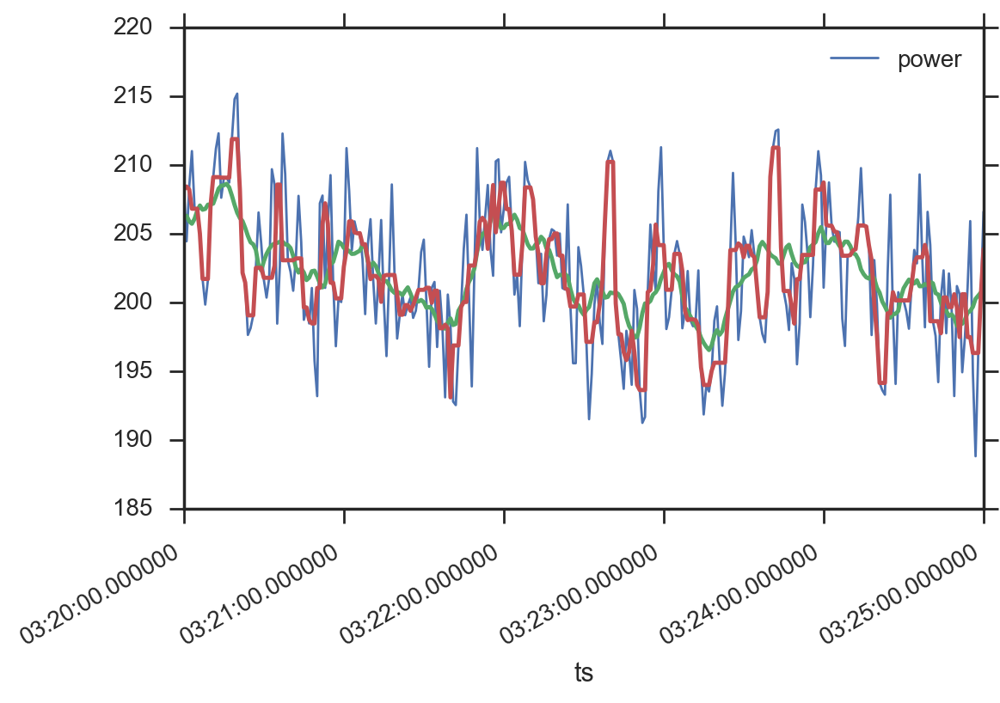

In [103]:
mf5 = pd.Series(signal.medfilt(power_standby.power, kernel_size=5), index=power_standby.index, name='mf_5')
mf11 = pd.Series(signal.wiener(power_standby.power, 15), index=power_standby.index, name='wiener_11')

t0, tf = '3:10', '3:20'
ax = power_standby.between_time(t0, tf).plot(lw=1)
mf5.between_time(t0, tf).plot(ax=ax)
mf11.between_time(t0, tf).plot(ax=ax)
plt.show()


t0, tf = '3:20', '3:25'
ax = power_standby.between_time(t0, tf).plot(lw=1)
mf11.between_time(t0, tf).plot(ax=ax)
mf5.between_time(t0, tf).plot(ax=ax)

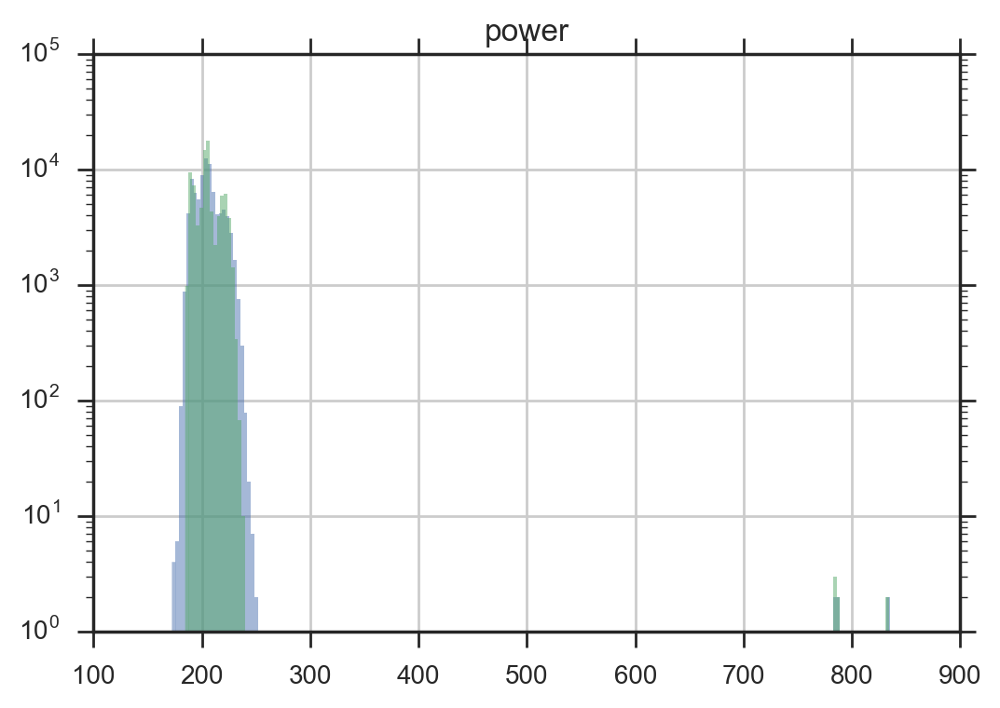

In [100]:
power_standby.hist(bins=200, lw=0, log=True, alpha=.5)
mf11.hist(bins=200, lw=0, log=True, alpha=.5)

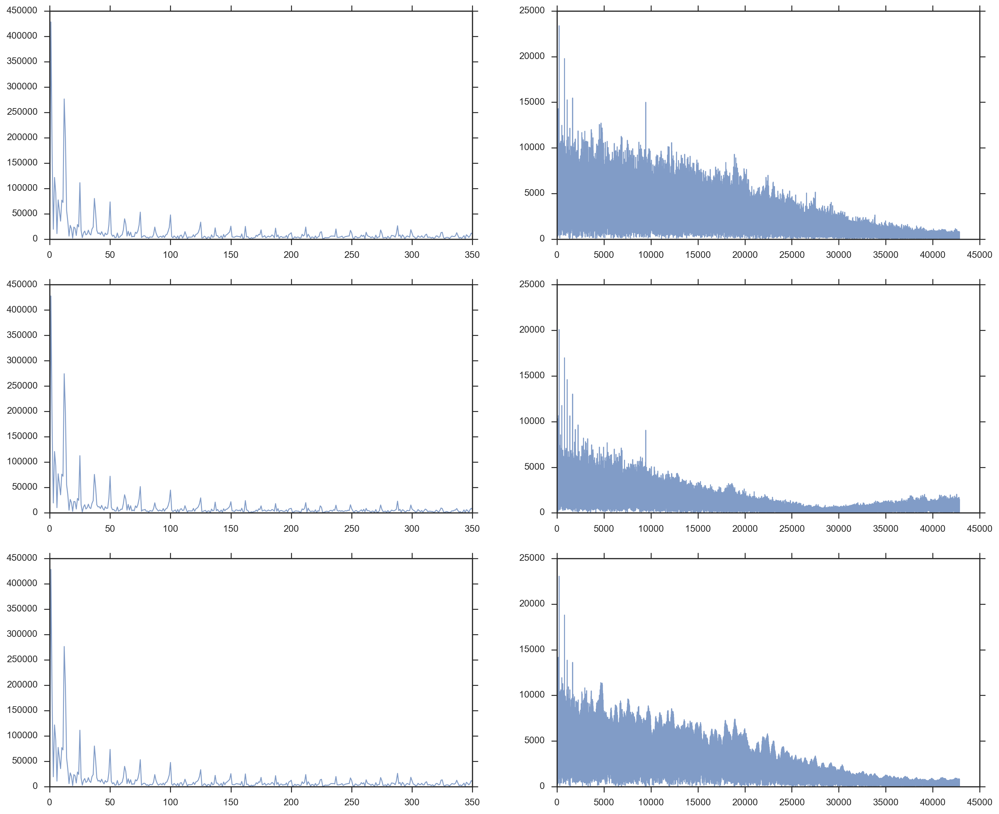

In [104]:
N = len(power_standby)
out_fft = np.fft.rfft((power_standby.power - power_standby.power.mean()).values)
out_fft_mf = np.fft.rfft((mf5 - mf5.mean()).values)
out_fft_mf2 = np.fft.rfft((mf11 - mf11.mean()).values)

plt.figure(figsize=(18, 15))
corte = 350 # seg

plt.subplot(3, 2, 1)
plt.plot(np.abs(out_fft[:corte + 1]), lw=1, alpha=.7)

plt.subplot(3, 2, 2)
plt.plot(np.abs(out_fft[corte:N//2]), lw=1, alpha=.7)

plt.subplot(3, 2, 3)
plt.plot(np.abs(out_fft_mf[:corte + 1]), lw=1, alpha=.7)

plt.subplot(3, 2, 4)
plt.plot(np.abs(out_fft_mf[corte:N//2]), lw=1, alpha=.7)

plt.subplot(3, 2, 5)
plt.plot(np.abs(out_fft_mf2[:corte + 1]), lw=1, alpha=.7)

plt.subplot(3, 2, 6)
plt.plot(np.abs(out_fft_mf2[corte:N//2]), lw=1, alpha=.7);

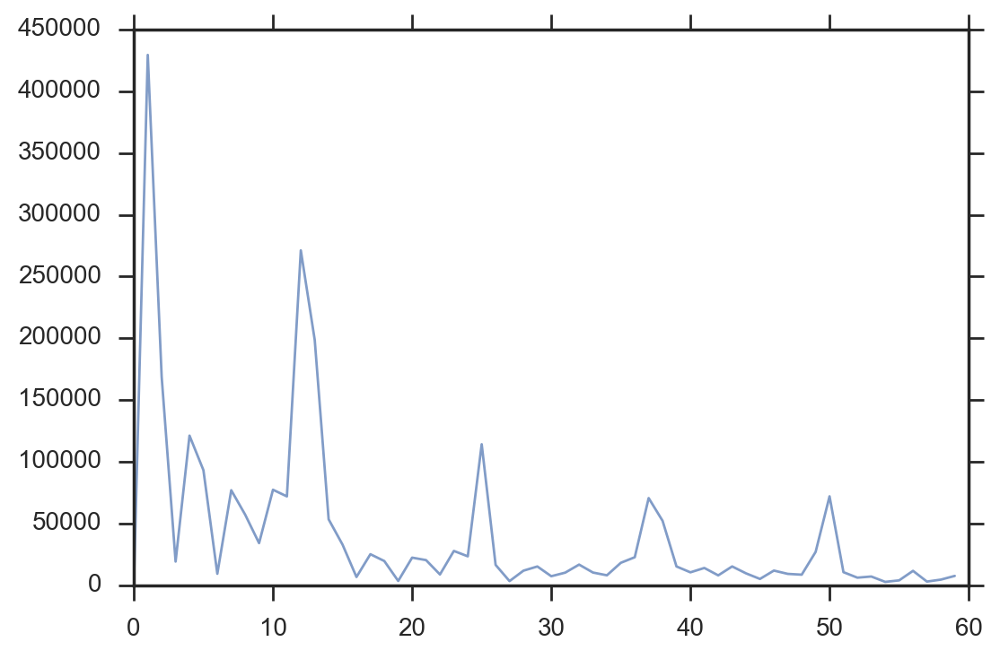

In [62]:
plt.plot(np.abs(out_fft_mf2[:60]), lw=1, alpha=.7);

## Extracting POWER events

In [312]:
@timeit('process_power', verbose=True)
def process_power(df_homog_power, 
                  kernel_size=15, roll_window_event=9, threshold_event=10,
                  margin_td=pd.Timedelta('120s'), 
                  margin_ant=pd.Timedelta('3s')):
    """
    Tomando una pd.DataFrame de 'POWER' homogéneo (con resample mean a 1s), 
        * aplica filtrado 'Wiener' a la señal raw,
        * calcula ∆_wiener, deltas de power entre samples
        * calcula ∆'_wiener con roll_window_event centrado, detectando máximos y mínimos locales 
        en los cambios de ∆_wiener, tomándolos como eventos de cambio.
        * Agrupa los eventos de cambio en subconjuntos separados, al menos, un pd.Timedelta 'margin_td'.
        (forma el evento desde inicio - pd.Timedelta 'margin_ant')
        
    return:
        df_power, list_index_events, df_feats_grupos
    """

    def _is_event(x):
        mid = len(x) // 2
        xmin = np.min(x)
        xmax = np.max(x)
        if ((xmax - xmin) > threshold_event):
            if (x[mid] == xmin):
                return -1
            elif (x[mid] == xmax):
                return 1
        return 0

    df_power = df_homog_power.copy()
    df_power['wiener'] = signal.wiener(df_power.power, kernel_size).astype('float32')
    df_power['medfilt'] = signal.medfilt(df_power.power, kernel_size).astype('float32')
    df_power['roll_std'] = df_power.wiener.rolling(11).std().astype('float32')
    
    df_power['deltas'] = df_power.wiener.diff().fillna(0)
    df_power['eventos'] = df_power['deltas'].diff().fillna(0).rolling(roll_window_event, center=True
                                                                     ).apply(_is_event).fillna(0).astype('int16')

    list_index_events = []
    last_event_init = None
    events_in_interval = []
    for t in df_power[df_power['eventos'] != 0].index:
        if last_event_init is None:
            events_in_interval.append(t)
        elif t > last_event_init + margin_td:
            list_index_events.append(events_in_interval)
            events_in_interval = [t]
        else:
            events_in_interval.append(t)
        last_event_init = t
    print_info('Nº de grupos de eventos: {} (para un nº de eventos total de: {})'
               .format(len(list_index_events), len(df_power[df_power['eventos'] != 0])))
    
    sub_events = []
    cols = ['power', 'medfilt', 'wiener', 'deltas', 'eventos']
    cols_feat_grupos = ['index_ge', 't0', 'duracion', 'wiener_min', 'wiener_mean', 'wiener_max', 'wiener_std', 'wiener_median', 
                        'eventos_sum', 'eventos_abs_sum', 'deltas_max', 'deltas_min', 'deltas_sum', 'deltas_abs_sum']    
    for i, ts in enumerate(list_index_events):
        t0, tf = ts[0] - margin_ant, ts[-1] + margin_td
        d_i = df_power.loc[t0:tf, cols]
        resumen_i = (i, d_i.index[0], len(d_i), 
                     d_i.wiener.min(), d_i.wiener.mean(), d_i.wiener.max(), d_i.wiener.std(), d_i.wiener.median(), 
                     d_i.eventos.sum(), d_i.eventos.abs().sum(), 
                     d_i.deltas.max(), d_i.deltas.min(), d_i.deltas.sum(), d_i.deltas.abs().sum())
        sub_events.append(resumen_i)
    df_feats_grupos = pd.DataFrame(sub_events, columns=cols_feat_grupos).set_index(cols_feat_grupos[0])
    return df_power, list_index_events, df_feats_grupos


df_power, list_index_events, df_feats_grupos = process_power(power_standby)
df_feats_grupos.describe()

Nº de grupos de eventos: 17 (para un nº de eventos total de: 76)
process_power TOOK: 0.617 s


,duracion,wiener_min,wiener_mean,wiener_max,wiener_std,wiener_median,eventos_sum,eventos_abs_sum,deltas_max,deltas_min,deltas_sum,deltas_abs_sum
count,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000,17.000000
mean,135.411765,199.682035,223.403936,625.716531,48.622832,217.295883,-0.411765,3.823529,300.269726,-321.312862,11.041497,917.991433
std,13.647613,7.877142,12.715661,271.574096,30.633446,10.808972,0.618347,1.878673,206.774374,216.144354,10.972383,546.265832
min,125.000000,183.800476,195.313873,199.724258,1.908688,195.211060,-1.000000,2.000000,4.854843,-538.085815,-7.720901,60.890289
25%,126.000000,191.858337,214.732132,228.876953,3.838038,206.394714,-1.000000,2.000000,6.840714,-475.280762,6.910400,210.743942
50%,133.000000,201.769867,221.992096,782.892639,65.986412,222.654984,0.000000,3.000000,332.166199,-411.596222,14.278900,1240.151489
75%,139.000000,202.746536,235.968719,797.213623,67.981680,226.001053,0.000000,5.000000,468.395691,-7.878113,19.508942,1260.545532
max,184.000000,211.386139,236.496643,833.998474,72.090804,229.557693,1.000000,9.000000,534.843872,-1.787735,25.805740,1352.484741


[array([ 44.27913015]), array([ 94.02152318]), array([ 206.76315789]), array([ 478.75609756]), array([ 937.25]), array([ 2040.]), array([ 3634.2]), array([ 4933.]), array([ 6104.])]


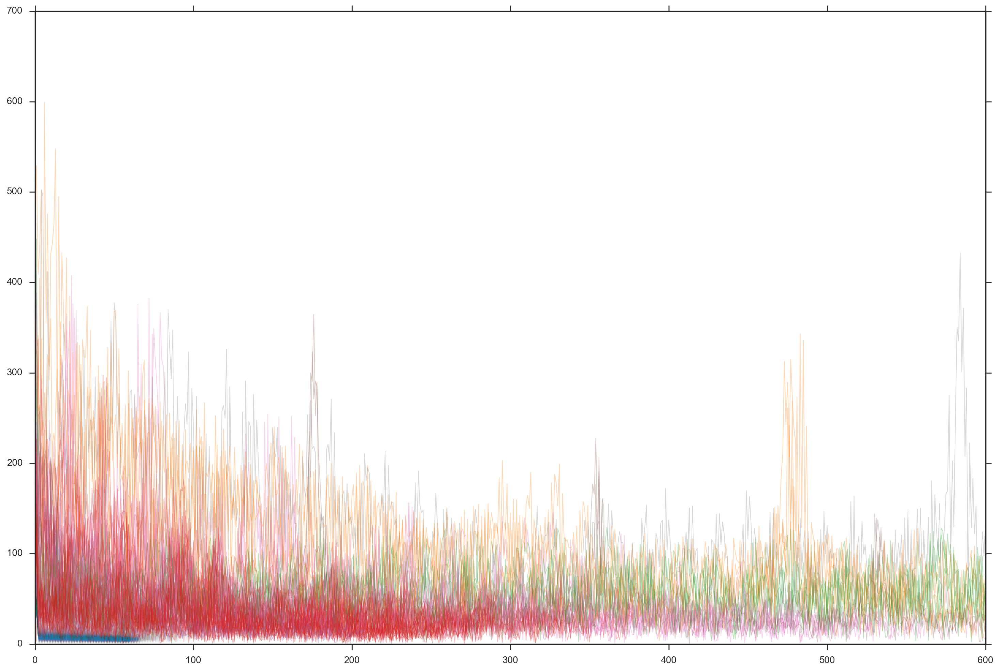

In [510]:
# Análisis frecuencial de eventos / comparación de fft's

# Separación de eventos por duración. KMeans++ de k clusters
k = 9
km_dur_event = KMeans(n_clusters=k, n_jobs=-1).fit(df_feats_grupos_all_2.duracion.values.reshape(-1, 1))
print_info(sorted(km_dur_event.cluster_centers_))

amplitudes = []
grupo_durac = []
for i, ts in enumerate(lista_grupos_eventos_total_2):
    t0, tf = ts[0] - margin_ant, ts[-1] + margin_td
    d_i = POWER_FILT_2.loc[t0:tf, cols]
    if len(d_i) > 5:
        w = blackman(len(d_i))
        amplitudes_i = np.sqrt(np.abs(scipy.fftpack.rfft(d_i.power * w)))[:(len(d_i) // 2)]
        #amplitudes_i = np.sqrt(np.abs(np.fft.rfft(d_i.power)))[:(len(d_i) // 2)]
        
        amplitudes.append(amplitudes_i)
        grupo_durac.append(km_dur_event.labels_[i])
        

colors = tableau20[::2][:len(km_dur_event.cluster_centers_)]
plt.figure(figsize=(18, 12))
for a, g in zip(amplitudes, grupo_durac):
    color = colors[g]
    if len(a) > 200:
        params = dict(lw=.75, alpha=.3, color=color)
    else:
        params = dict(lw=.1, alpha=.01, color=color)
    plt.plot(a[2:], **params)
plt.xlim(0, 600);

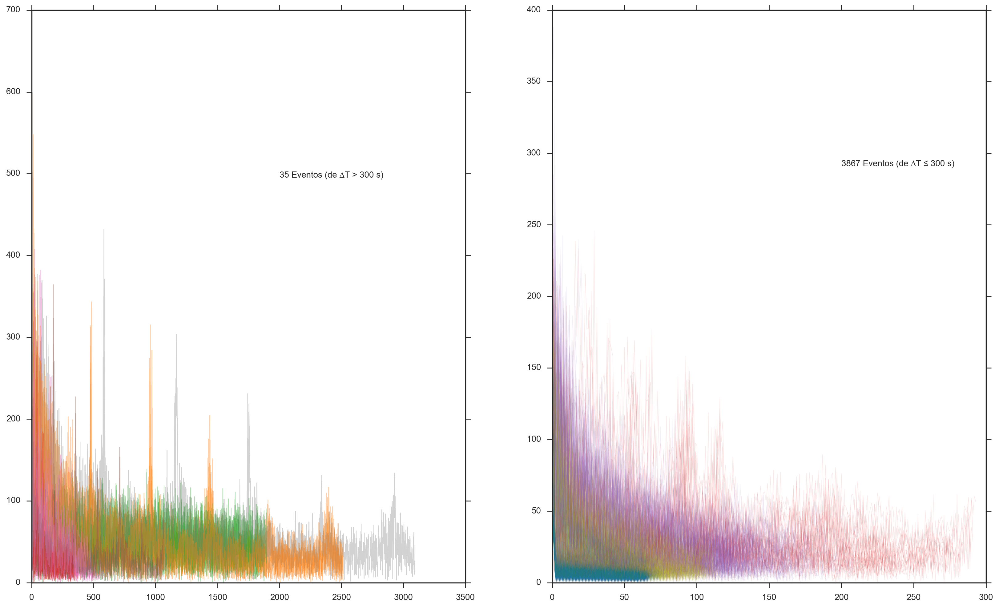

In [511]:
f, axes = plt.subplots(1, 2, figsize=(20, 12))

ymax, ne = 0, 0
for a, g in zip(amplitudes, grupo_durac):
    color = colors[g]
    if len(a) > 300:
        params = dict(lw=.75, alpha=.35, color=color)
        axes[0].plot(a[2:], **params)
        ne += 1
        ymax = max(ymax, max(a[2:]))
axes[0].annotate('{} Eventos (de ∆T > {} s)'.format(ne, 300), (2000, ymax * .75), ha='left')

ymax, ne = 0, 0
for a, g in zip(amplitudes, grupo_durac):
    color = colors[g]
    if len(a) <= 300:
        if len(a) <= 100:
            params = dict(lw=.25, alpha=.03, color=color)
        else:
            params = dict(lw=.5, alpha=.1, color=color)
        axes[1].plot(a[2:], **params)
        ne += 1
        ymax = max(ymax, max(a[2:]))
axes[1].annotate('{} Eventos (de ∆T ≤ {} s)'.format(ne, 300), (200, ymax * .75), ha='left')
axes[1].set_xlim(0, 300);

Hay 35 eventos de larga duración (∆T_medio=1888.7428571428572)

plot_mosaico_eventos TOOK: 12.457 s


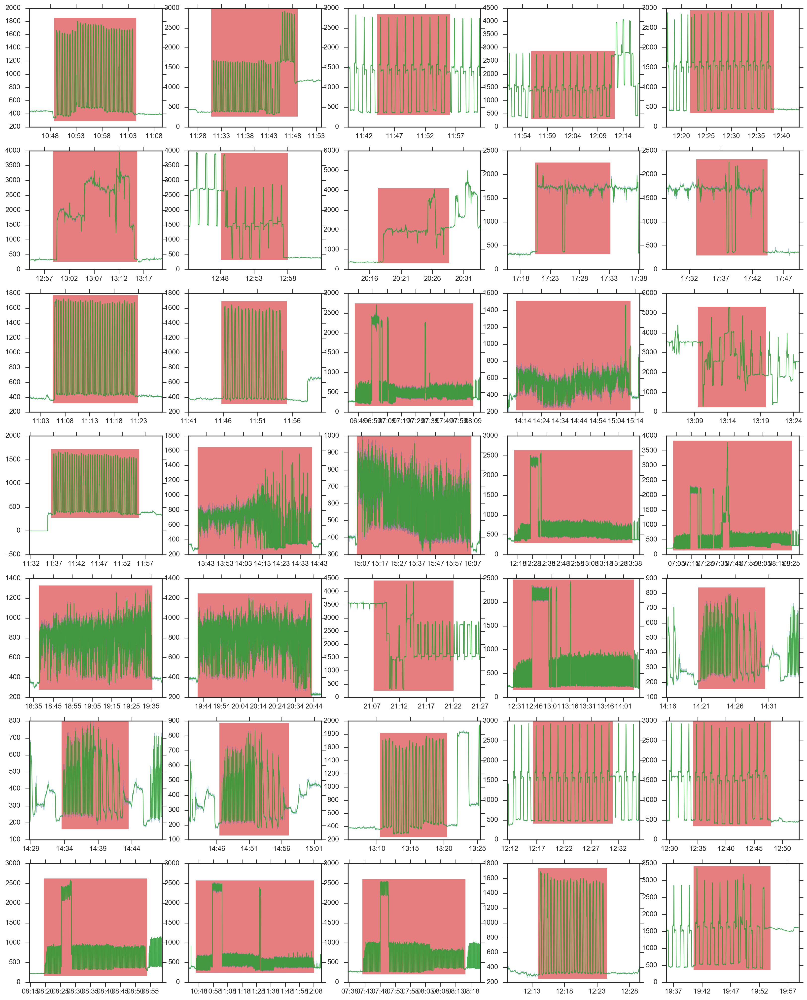

In [487]:
big_events = df_feats_grupos_all_2[df_feats_grupos_all_2.duracion > 554]
print_info('Hay {} eventos de larga duración (∆T_medio={:.1} s)\n'.format(len(big_events), big_events.duracion.mean()))

plot_mosaico_eventos(POWER_FILT_2, big_events, n_rows=7, n_cols=5, size=4)

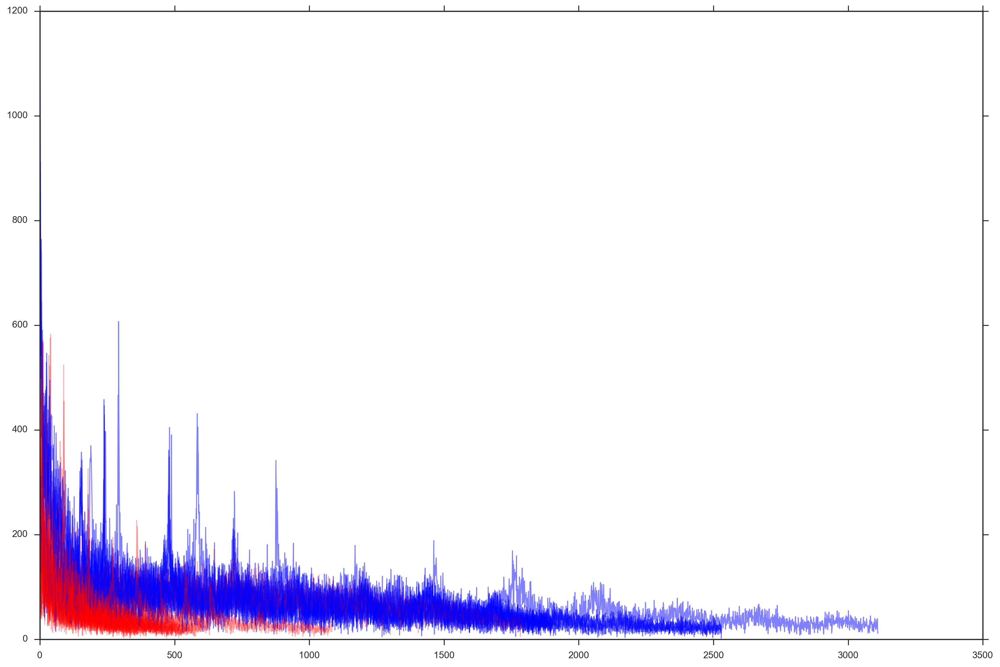

In [490]:
amplitudes = []
for t0, dur in zip(big_events.t0, big_events.duracion):
    tf = t0 + pd.Timedelta(seconds=dur) + margin_td
    t0 -= margin_ant
    d_i = POWER_FILT_2.loc[t0:tf, cols]
    if len(d_i) > 5:
        amplitudes_i = np.sqrt(np.abs(np.fft.rfft(d_i.power)))[:(len(d_i) // 2)]
        amplitudes.append(amplitudes_i)
        
        
plt.figure(figsize=(18, 12))
for a in amplitudes:
    if len(a) > 1800:
        params = dict(lw=1, alpha=.5, color='b')
    else:
        params = dict(lw=1, alpha=.3, color='r')
    plt.plot(a[2:], **params)
#plt.xlim(0, 600);

ts
2016-08-24 00:33:05+02:00    240.281982
2016-08-24 00:33:06+02:00    252.030426
2016-08-24 00:33:07+02:00    244.846771
2016-08-24 00:33:08+02:00    227.035446
2016-08-24 00:33:09+02:00    228.060532
2016-08-24 00:33:10+02:00    241.670258
2016-08-24 00:33:11+02:00    261.747406
2016-08-24 00:33:12+02:00    250.801636
2016-08-24 00:33:13+02:00    248.085449
2016-08-24 00:33:14+02:00    255.234711
Freq: S, Name: power, dtype: float32


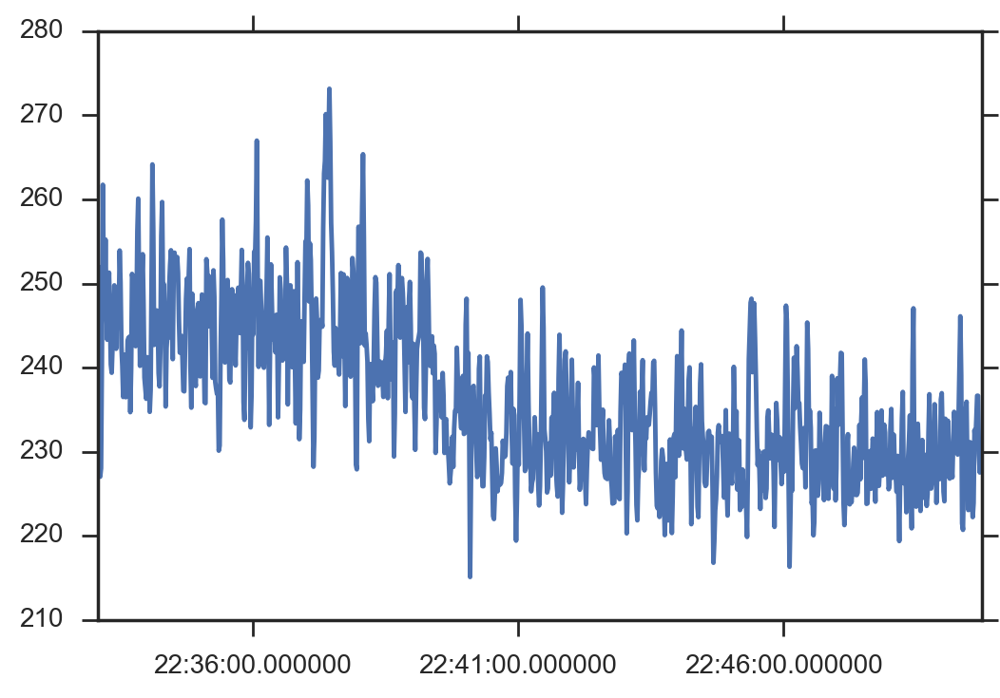

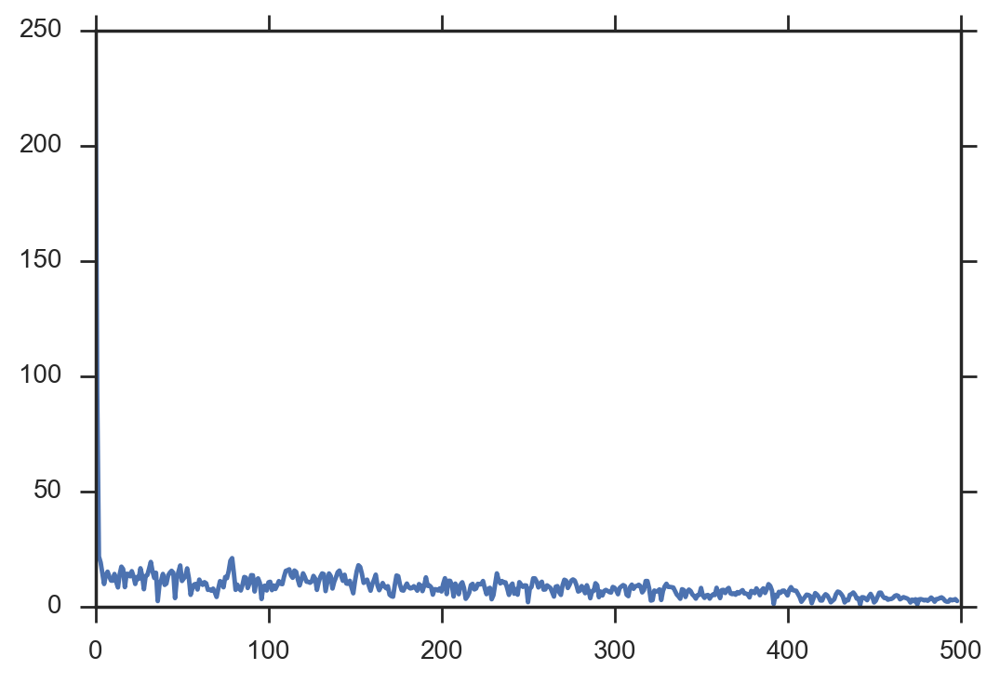

In [509]:
from scipy.signal import blackman
from scipy.signal import hanning


x_fft = POWER_FILT_2.iloc[1000000:1001000].power
w = blackman(len(x_fft))
print_red(x_fft.head(10))

plt.plot(x_fft)
plt.show()
plt.plot(np.sqrt(np.abs(scipy.fftpack.fft(x_fft * w)))[1:len(x_fft) // 2])


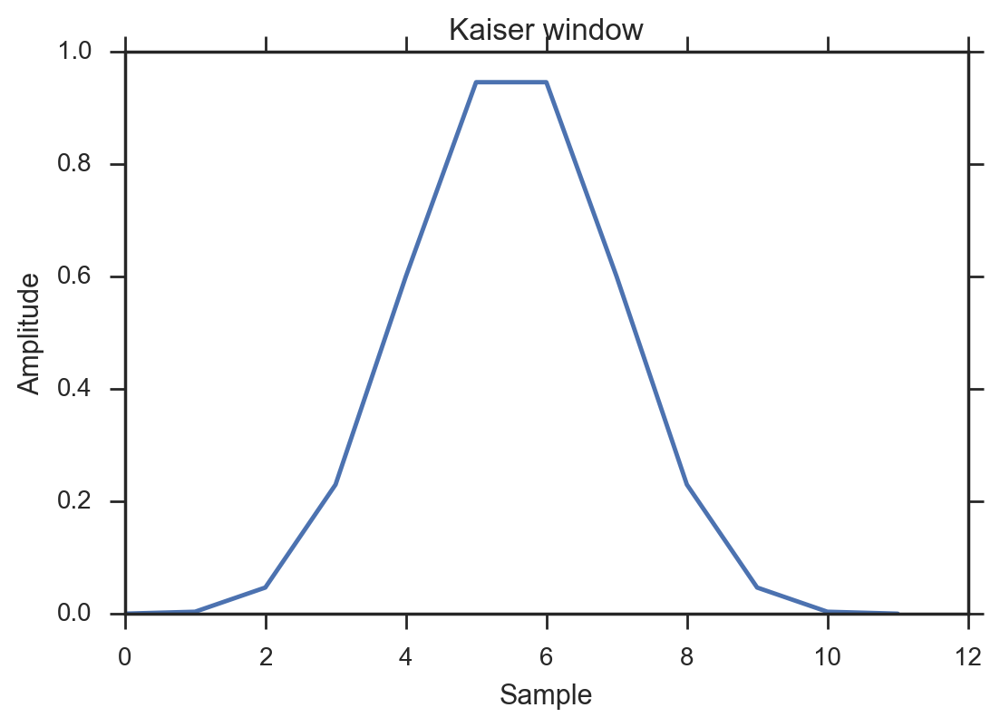

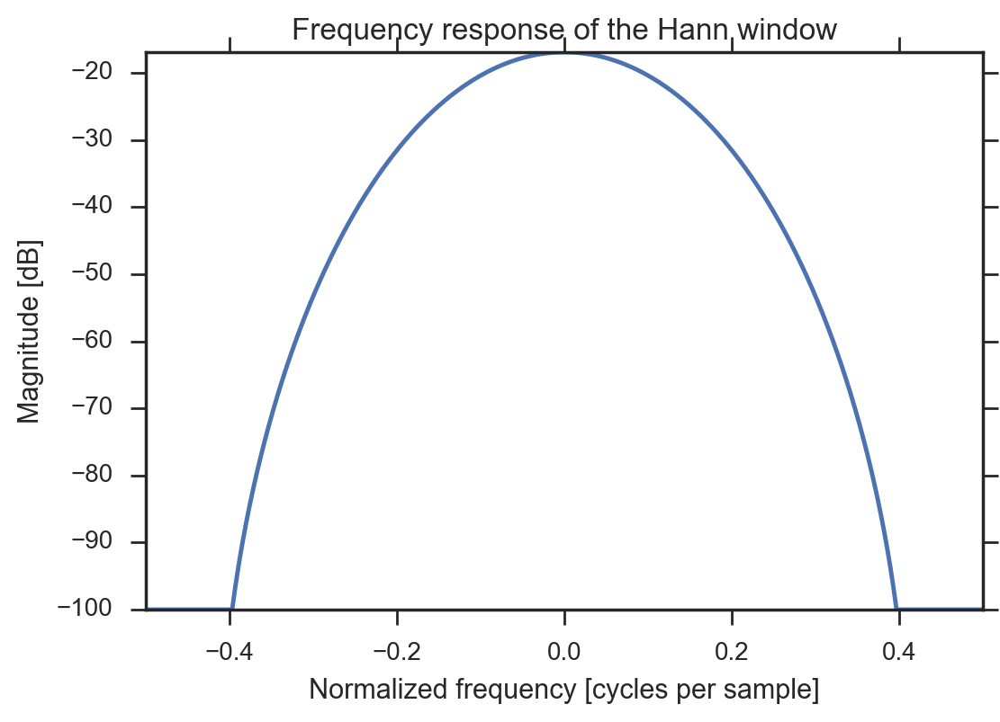

In [495]:

#window = np.hanning(51)
window = np.kaiser(12, 14)
plt.plot(window)
#plt.title("Hann window")
plt.title("Kaiser window")
plt.ylabel("Amplitude")
plt.xlabel("Sample")
plt.show()


plt.figure()

A = np.fft.fft(window, 2048) / 25.5
mag = np.abs(np.fft.fftshift(A))
freq = np.linspace(-0.5, 0.5, len(A))
response = 20 * np.log10(mag)
response = np.clip(response, -100, 100)
plt.plot(freq, response)

plt.title("Frequency response of the Hann window")
plt.ylabel("Magnitude [dB]")
plt.xlabel("Normalized frequency [cycles per sample]")
plt.axis('tight')
plt.show()

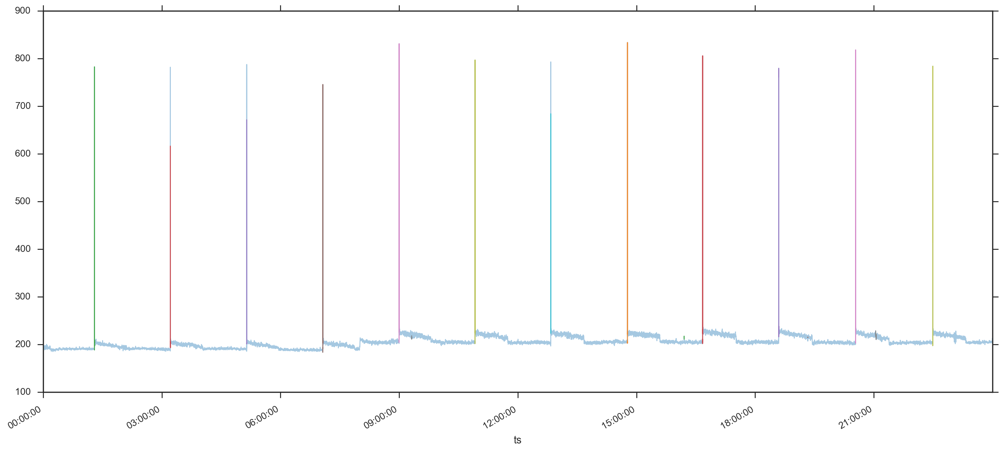

In [237]:
from itertools import cycle

cm = cycle(tableau20[2::2])
ax = df_power.wiener.plot(figsize=(18, 8), lw=1, color=tableau20[0], alpha=.4)

for tt in list_index_events:
    ax = df_power.wiener.loc[tt[0]:tt[-1]].plot(ax=ax, lw=1, color=next(cm), alpha=.8)


### PLOT Events

In [539]:
import matplotlib.patches as mpp


@timeit('plot_power_events', verbose=True)
def plot_power_events(df_power, df_feats_grupos):
    margin_y = 50
    frac_day = 1. / (24*60*60.)
    df_feats_p = df_feats_grupos.copy()
    df_feats_p['tf'] = df_feats_p['t0'] + df_feats_p.duracion.apply(lambda x: pd.Timedelta(seconds=x))
    
    f, ax = plt.subplots(1, 1, figsize=(18, 8))
    df_power.wiener.plot(ax=ax, lw=1, color=tableau20[4], alpha=.7)
    for i, row in df_feats_p.iterrows():
        r = mpp.Rectangle((mpd.date2num(row.t0) - 15 * frac_day, row.wiener_min - margin_y), 
                          row.duracion * frac_day + 15 * frac_day, row.wiener_max - row.wiener_min + 2 * margin_y, 
                          fill=True, lw=0, alpha=.6, fc=tableau20[6])
        ax.add_patch(r)
    ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M'))
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, ha='center')
    ax.xaxis.set_tick_params(labelsize=10)
    ax.xaxis.set_tick_params(pad=3)
    ax.set_xlabel('')
    
    
def _plot_row_evento(df_i, ax=None, row=None, with_raw=True):
    margin_y = 50
    frac_day = 1. / (24*60*60.)
    
    if ax is None:
        _, ax = plt.subplots(1, 1)
    ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M'))
    if with_raw:
        df_i['power'].plot(ax=ax, lw=.5, color=tableau20[0], alpha=.4)
    df_i['wiener'].plot(ax=ax, lw=1, color=tableau20[4], alpha=.8)
    if row is not None:
        r = mpp.Rectangle((mpd.date2num(row.t0) - 15 * frac_day, row.wiener_min - margin_y), 
                          row.duracion * frac_day + 15 * frac_day, row.wiener_max - row.wiener_min + 2 * margin_y, 
                          fill=True, lw=0, alpha=.6, fc=tableau20[6])
        ax.add_patch(r)
        ax.annotate('E_{}'.format(row.name), (.07, .9), xycoords='axes fraction')
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, ha='center')
    ax.xaxis.set_tick_params(labelsize=10)
    ax.xaxis.set_tick_params(pad=3)
    ax.set_xlabel('')
    return ax

    
@timeit('plot_mosaico_eventos', verbose=True)
def plot_mosaico_eventos(df_power, df_feats_grupos, n_rows=3, n_cols=3, size=5):
    
    margin_event = pd.Timedelta('5min')
    df_feats_p = df_feats_grupos.copy()
    df_feats_p['tf'] = df_feats_p['t0'] + df_feats_p.duracion.apply(lambda x: pd.Timedelta(seconds=x))
    
    f, axes = plt.subplots(n_rows, n_cols, figsize=(size * n_cols, size * n_rows))
    axes = axes.ravel()
    for i, (i_r, row) in enumerate(df_feats_p.iterrows()):
        if i >= len(axes):
            break
        df_i = df_power.loc[row.t0 - margin_event: row.tf + margin_event]
        ax = _plot_row_evento(df_i, axes[i], row, with_raw=True)

Nº de grupos de eventos: 17 (para un nº de eventos total de: 76)
process_power TOOK: 0.637 s
plot_power_events TOOK: 5.784 s


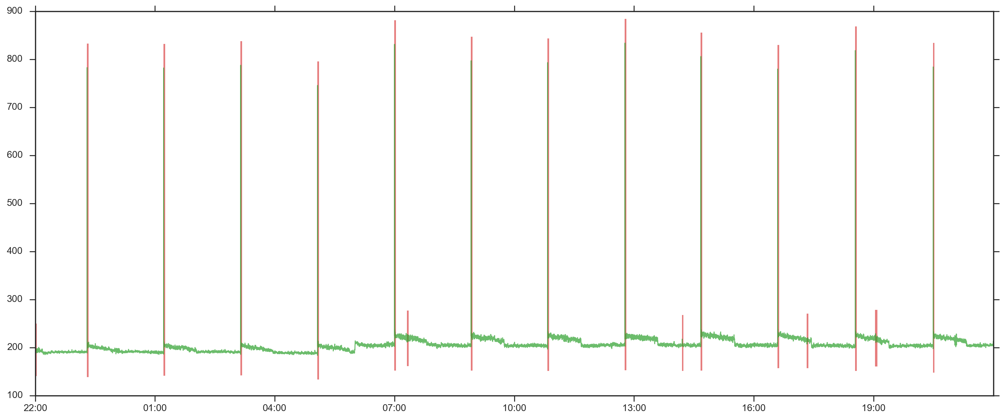

plot_mosaico_eventos TOOK: 1.565 s


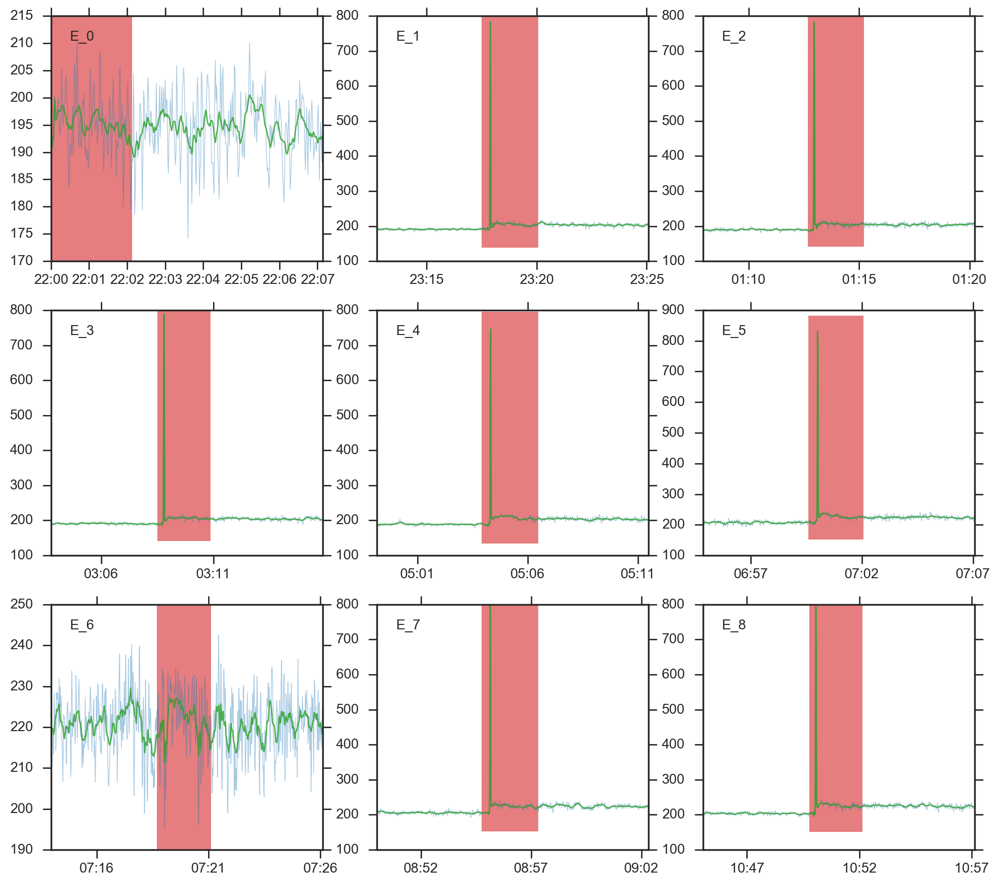

plot_mosaico_eventos TOOK: 1.202 s


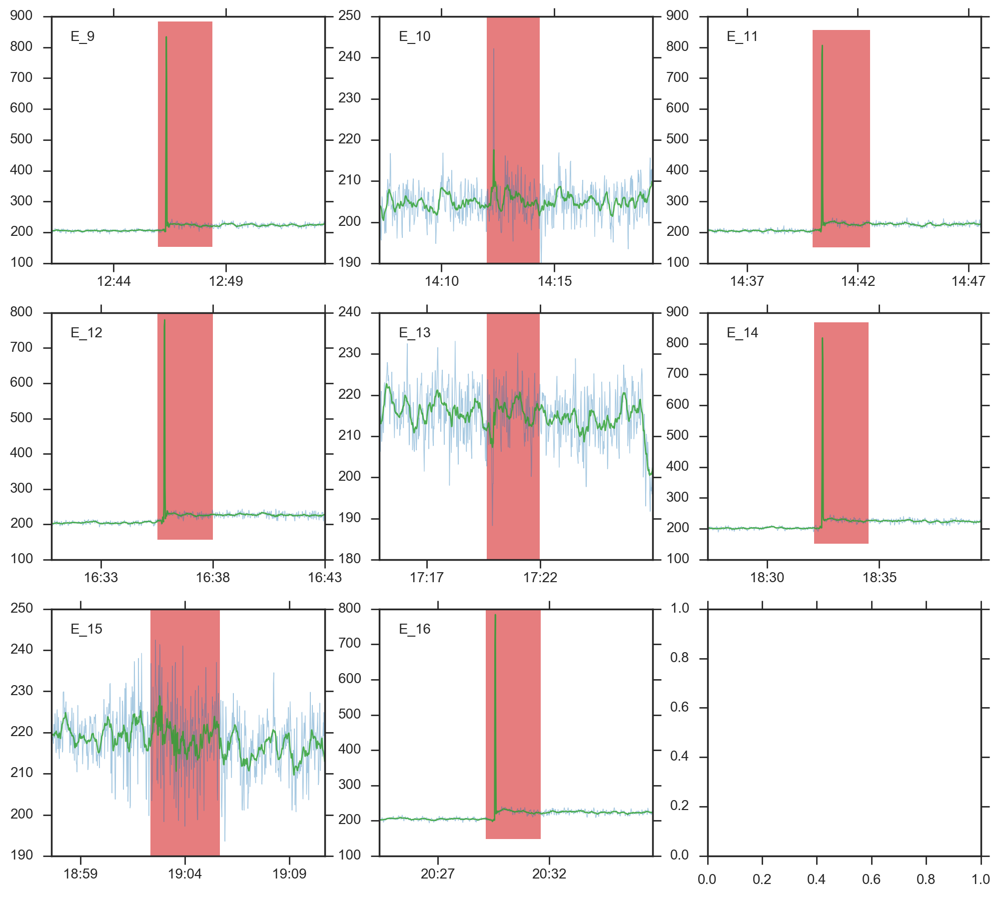

In [540]:
df_power, list_index_events, df_feats_grupos = process_power(homog_power.loc['2016-08-29'])

plot_power_events(df_power, df_feats_grupos)
plt.show()
                     
plot_mosaico_eventos(df_power, df_feats_grupos, n_rows=3, n_cols=3, size=4)
plt.show()
plot_mosaico_eventos(df_power, df_feats_grupos.iloc[9:], n_rows=3, n_cols=3, size=4)

Nº de grupos de eventos: 28 (para un nº de eventos total de: 211)
process_power TOOK: 0.558 s
plot_power_events TOOK: 4.923 s


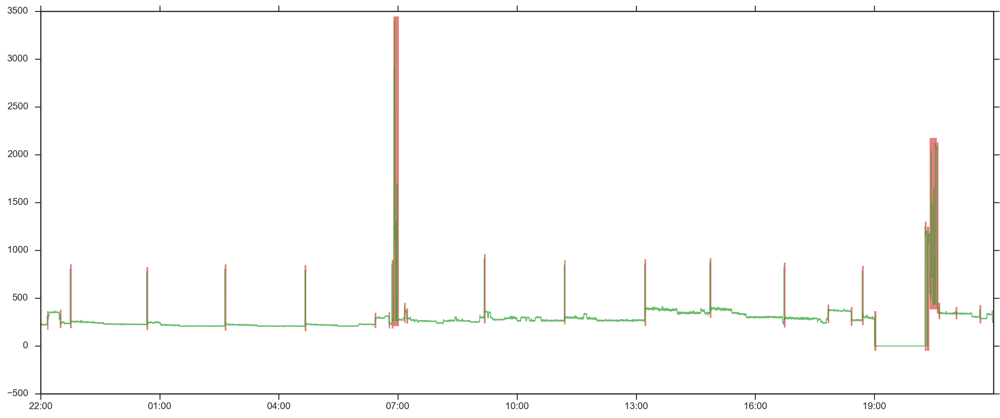

plot_mosaico_eventos TOOK: 2.744 s


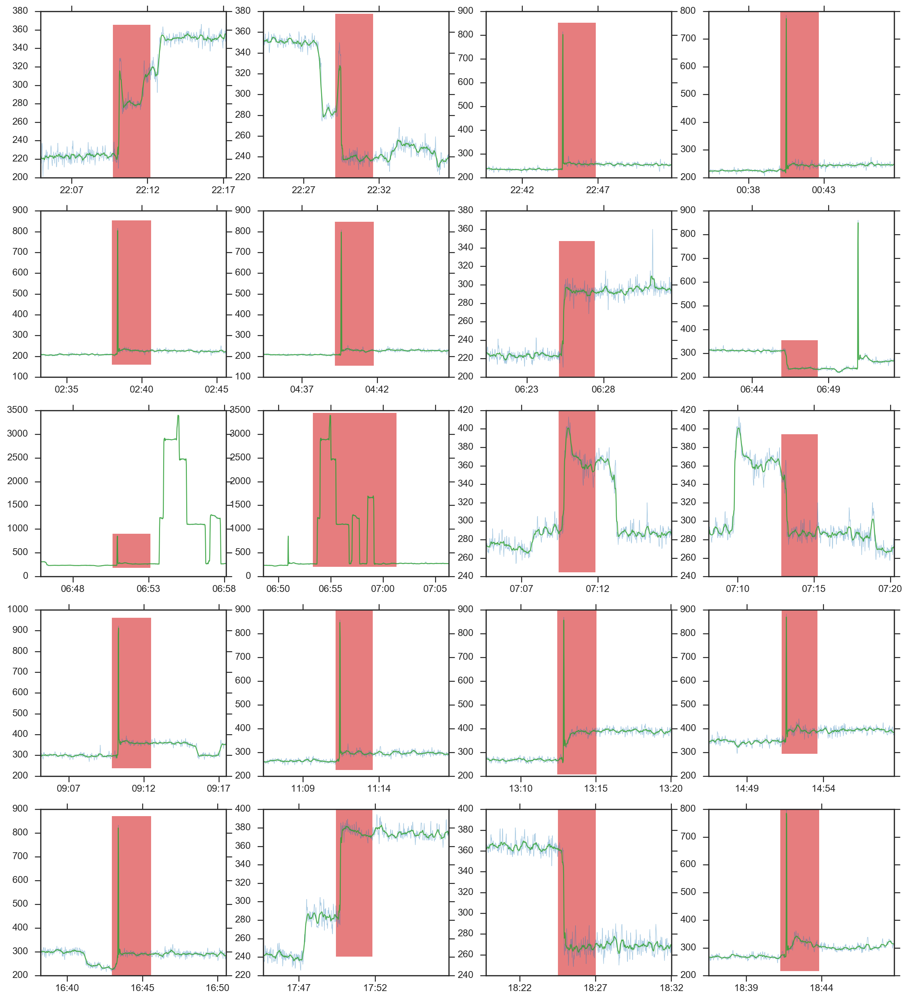

In [300]:
df_power, list_index_events, df_feats_grupos = process_power(homog_power.loc['2016-08-13'])
plot_power_events(df_power, df_feats_grupos)
plt.show()
                     
plot_mosaico_eventos(df_power, df_feats_grupos, n_rows=5, n_cols=4, size=4)

In [518]:
ax.annotate?

In [313]:
process_params = dict(kernel_size=15, roll_window_event=9, threshold_event=10,
                      margin_td=pd.Timedelta('120s'), margin_ant=pd.Timedelta('3s'))
POWER_FILT, lista_grupos_eventos_total, df_feats_grupos_all = process_power(homog_power, **process_params)
POWER_FILT.info()
df_feats_grupos_all.columns

Nº de grupos de eventos: 1174 (para un nº de eventos total de: 29587)
process_power TOOK: 26.207 s
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3726199 entries, 2016-08-12 10:46:25+02:00 to 2016-09-24 13:49:43+02:00
Freq: S
Data columns (total 5 columns):
power      float32
wiener     float32
medfilt    float32
deltas     float32
eventos    int16
dtypes: float32(4), int16(1)
memory usage: 92.4 MB


Index(['t0', 'duracion', 'wiener_min', 'wiener_mean', 'wiener_max', 'wiener_std', 'wiener_median', 'eventos_sum',
       'eventos_abs_sum', 'deltas_max', 'deltas_min', 'deltas_sum', 'deltas_abs_sum'],
      dtype='object')

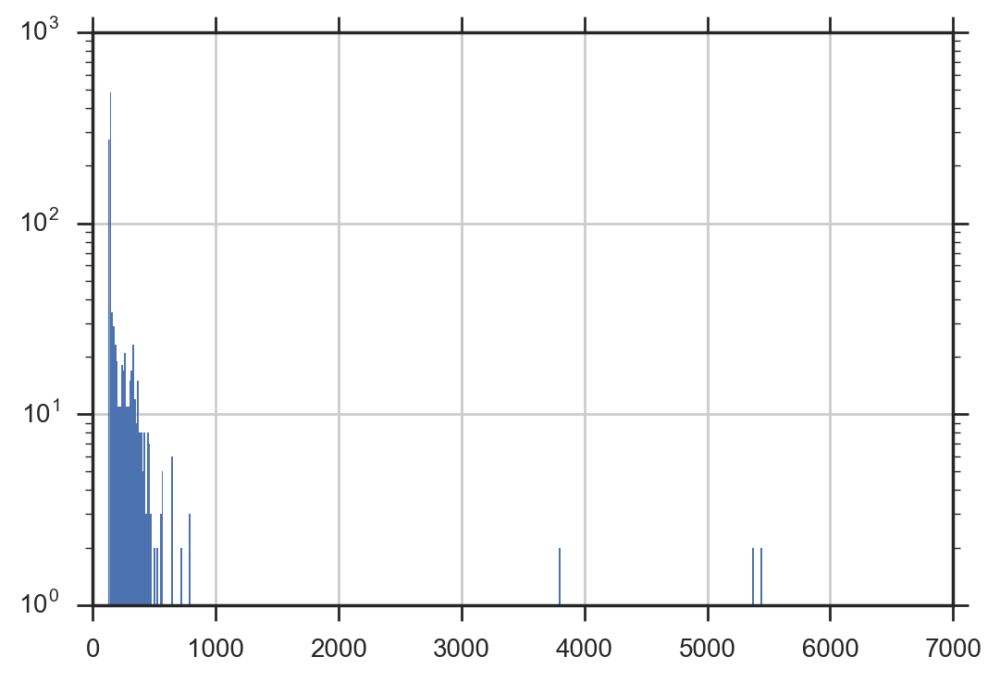

In [304]:
df_feats_grupos_all.duracion.hist(bins=500, lw=0, log=True)

plot_mosaico_eventos TOOK: 1.605 s


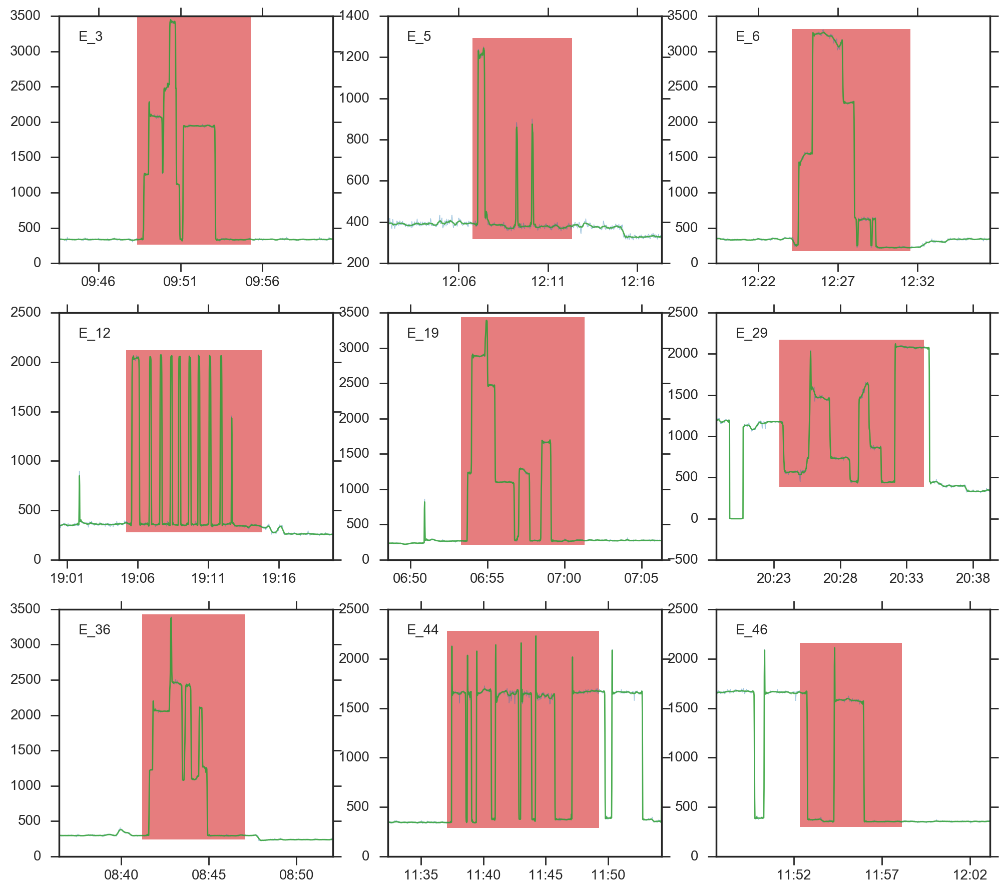

In [522]:
plot_mosaico_eventos(POWER_FILT, df_feats_grupos_all[df_feats_grupos_all.duracion > 300], 
                     n_rows=3, n_cols=3, size=4)

Nº de grupos de eventos: 3902 (para un nº de eventos total de: 49152)
process_power TOOK: 29.953 s


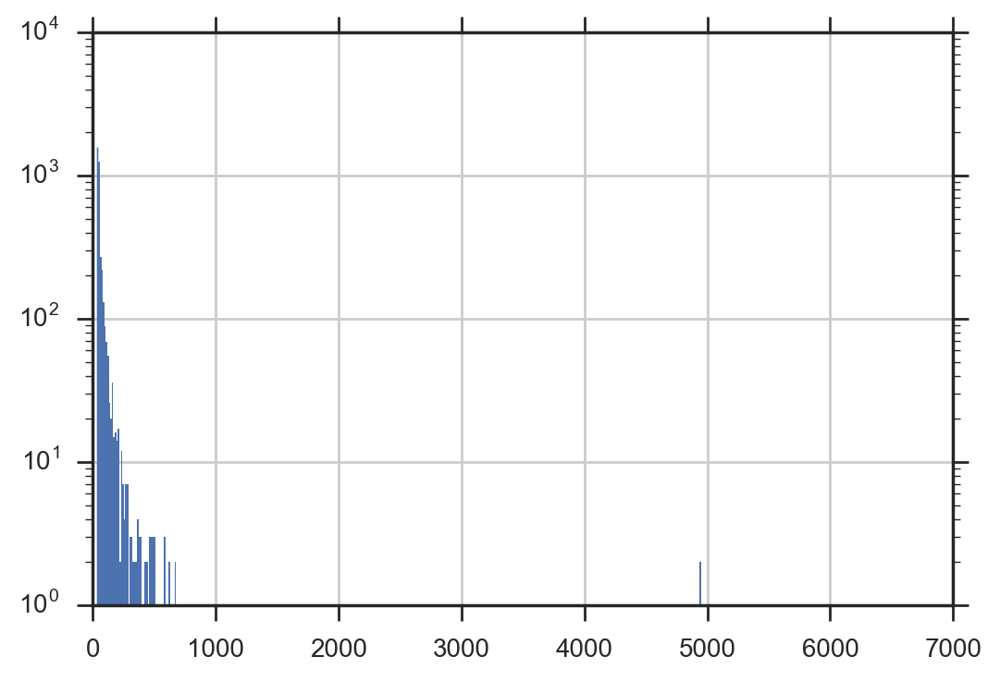

In [321]:
process_params_2 = dict(kernel_size=11, roll_window_event=7, threshold_event=7,
                        margin_td=pd.Timedelta('30s'), margin_ant=pd.Timedelta('2s'))
POWER_FILT_2, lista_grupos_eventos_total_2, df_feats_grupos_all_2 = process_power(homog_power, **process_params_2)
df_feats_grupos_all_2.duracion.hist(bins=500, lw=0, log=True)

plot_mosaico_eventos TOOK: 11.402 s


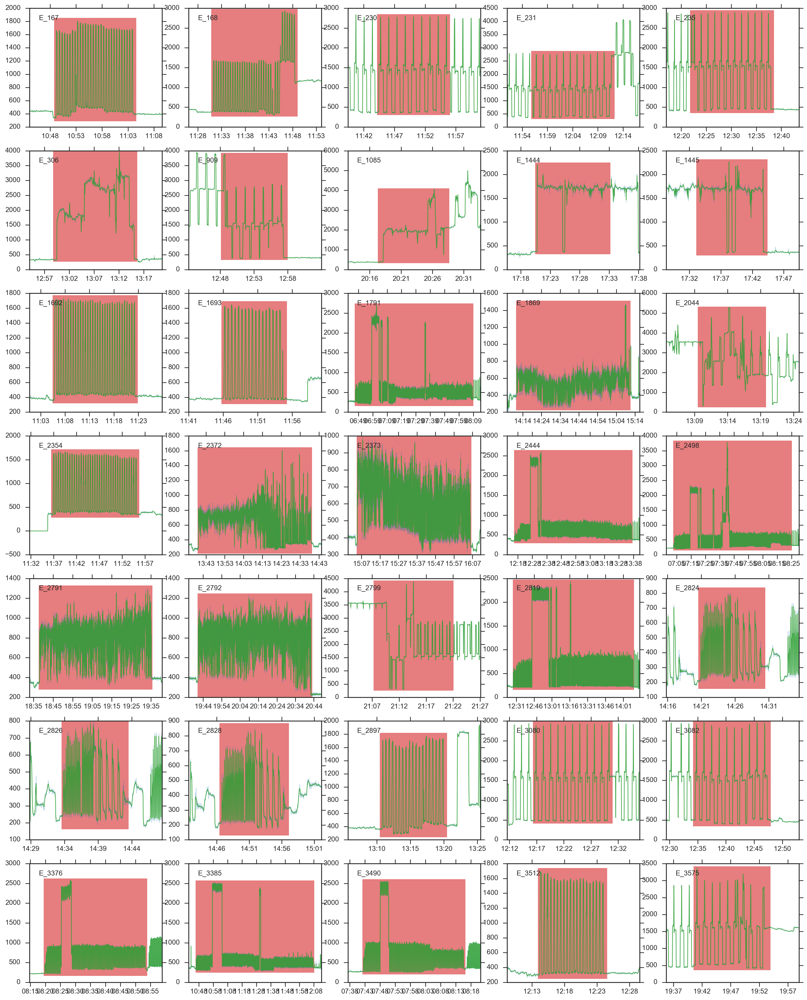

,t0,duracion,wiener_min,wiener_mean,wiener_max,wiener_std,wiener_median,eventos_sum,eventos_abs_sum,deltas_max,deltas_min,deltas_sum,deltas_abs_sum
index_ge,,,,,,,,,,,,,
168,2016-08-15 13:31:06+02:00,1079,311.193390,1028.114746,2928.174316,696.325804,860.590393,-5,273,493.176849,-651.105957,759.866699,90460.734375
306,2016-08-17 14:59:00+02:00,1003,318.768066,2268.884521,3947.953613,777.626035,2599.294678,10,272,821.583740,-523.239136,14.204346,29463.310547
1692,2016-08-23 13:05:44+02:00,1028,368.142700,845.181152,1725.723999,525.455844,456.233032,0,264,564.151123,-649.993408,41.664764,86056.617188
1791,2016-08-24 08:46:43+02:00,4941,200.192764,665.801636,2697.358154,529.791026,548.091492,-22,1394,950.543091,-858.963745,110.653015,181397.656250
1869,2016-08-24 16:10:39+02:00,3655,270.432892,560.014343,1462.220459,111.440515,567.709839,34,1058,437.883606,-433.254639,7.465302,159333.484375


In [527]:
plot_mosaico_eventos(POWER_FILT_2, df_feats_grupos_all_2[df_feats_grupos_all_2.duracion > 550], 
                     n_rows=7, n_cols=5, size=4)
plt.show()
df_feats_grupos_all_2[df_feats_grupos_all_2.duracion > 1000].head()

* Evento 3512. Features:
                             t0 duracion wiener_min wiener_mean wiener_max wiener_std wiener_median eventos_sum  \
3512  2016-09-20 14:14:11+02:00      624    297.738     723.665     1690.4    525.971       336.845           8   

     eventos_abs_sum deltas_max deltas_min deltas_sum deltas_abs_sum  
3512             160    719.185    -684.29    12.2385        53386.1  
Head:
                                power      wiener     medfilt      deltas  eventos  intervalo
ts                                                                                           
2016-09-20 14:14:11+02:00  320.202942  324.458282  318.347992   16.946106        0       3513
2016-09-20 14:14:12+02:00  318.347992  322.300629  320.202942   -2.157654        0       3513
2016-09-20 14:14:13+02:00  778.441284  778.724243  778.441284  456.423615        1       3513
Tail:
                                power      wiener     medfilt    deltas  eventos  intervalo
ts                          

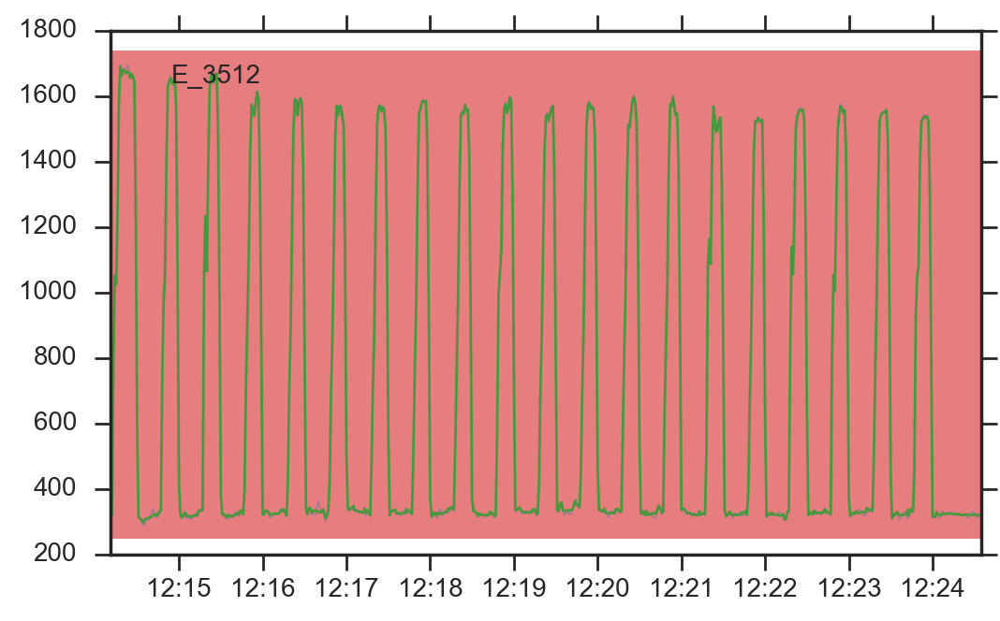

In [543]:
def _get_evento(id_ev, df_feats_grupos, df_power, verbose=False):
    df_ev_f = df_feats_grupos.loc[id_ev]
    #df_ev = df_power[df_power.intervalo == id_ev + 1]
    df_ev = df_power.loc[df_ev_f.t0:df_ev_f.t0 + pd.Timedelta(seconds=df_ev_f.duracion)]
    if verbose:
        print_info('* Evento {}. Features:\n{}\nHead:\n{}\nTail:\n{}'
                   .format(id_ev, pd.DataFrame(df_ev_f).T, df_ev.head(3), df_ev.tail(3)))
    return df_ev
    
_plot_row_evento(_get_evento(3512, df_feats_grupos_all_2, POWER_FILT_2, verbose=True), row=df_feats_grupos_all_2.loc[3512]);

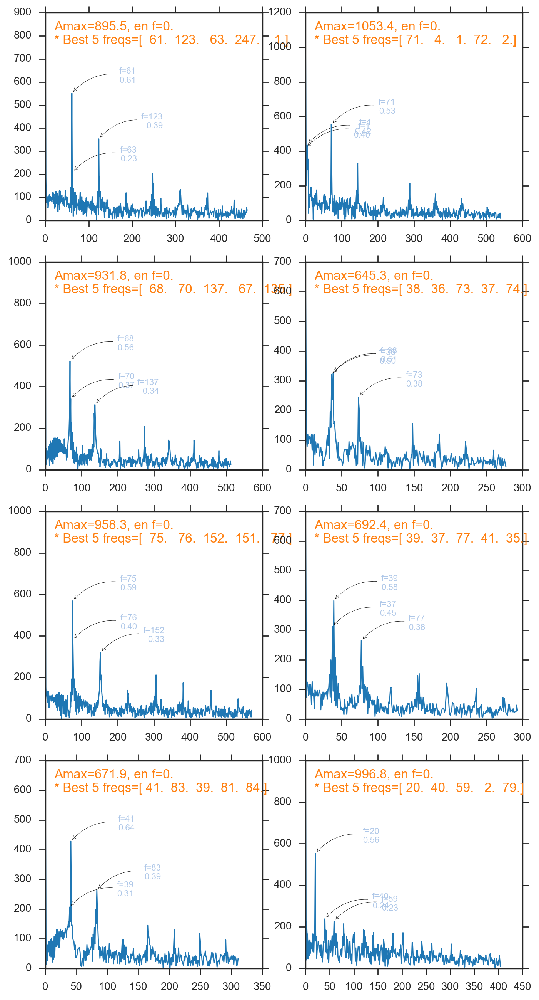

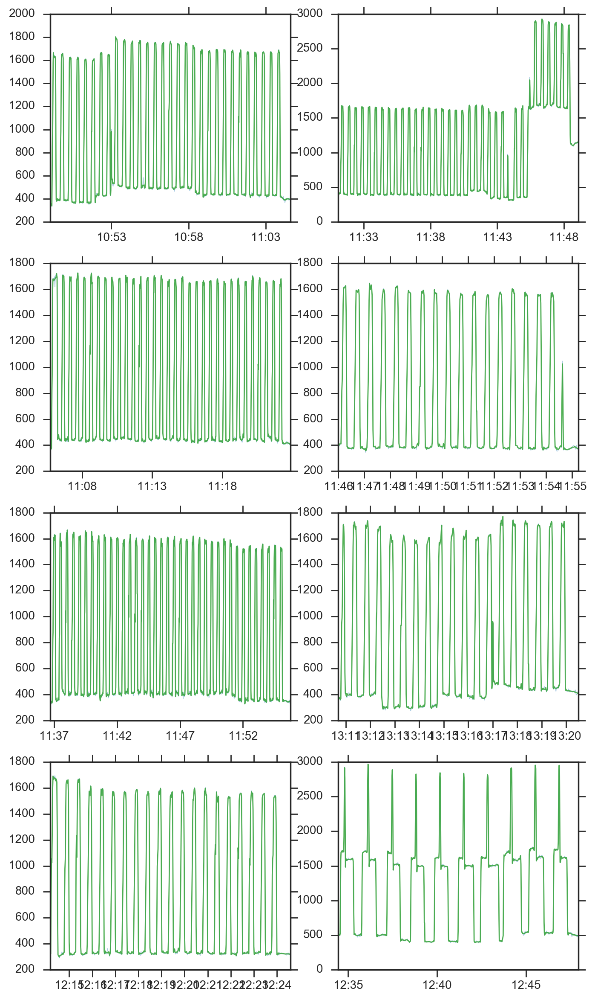

In [613]:
grupo_1 = [167, 168, 1692, 1693, 2354, 2897, 3512, 3082]  # 3082 no es del grupo

f, axes = plt.subplots(4, 2, figsize=(8, 16))
f2, axes_2 = plt.subplots(4, 2, figsize=(8, 16))
for id_ev, ax, ax_2 in zip(grupo_1, axes.ravel(), axes_2.ravel()):
    df_i = _get_evento(id_ev, df_feats_grupos_all_2, POWER_FILT_2)
    fft_mag_i = np.sqrt(np.abs(scipy.fftpack.rfft(df_i.power)[:len(df_i) // 2]))
    
    abs_freqs = np.array(list(sorted(zip(fft_mag_i[1:], range(1, fft_mag_i.shape[0])), reverse=True)))
    #abs_freqs.sort(axis=0)
    
    #print(np.argmax(fft_mag_i[1:]), fft_mag_i[np.argmax(fft_mag_i[1:]) + 1])
    
    ax.plot(fft_mag_i, lw=1, color=tableau20[0])
    max_abs, idx_max_abs = np.max(fft_mag_i), np.argmax(fft_mag_i)
    for a, f in abs_freqs[:3,:]:
        ax.annotate('f={}\n{:.2f}'.format(int(f), a / max_abs), (f, a),
                    xytext=(60, 10), textcoords='offset points', ha='right', fontsize=8, color=tableau20[1], 
                    arrowprops=dict(arrowstyle="->",
                                connectionstyle="arc3,rad=0.3"))
    ax.annotate('Amax={:.1f}, en f={:.0f}.\n* Best 5 freqs={}'.format(max_abs, idx_max_abs, abs_freqs[:5,1]), (.04, .85),
                xycoords='axes fraction', ha='left', fontsize=12, color=tableau20[2])

    
    _plot_row_evento(df_i, ax=ax_2)

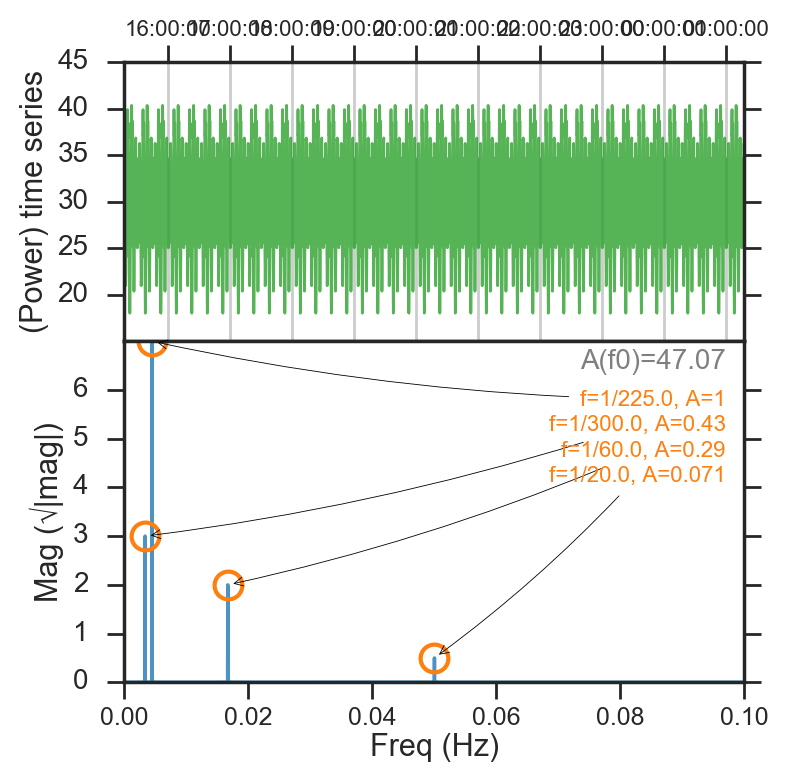

CALC FFT FEATURES TOOK: 1.695 s


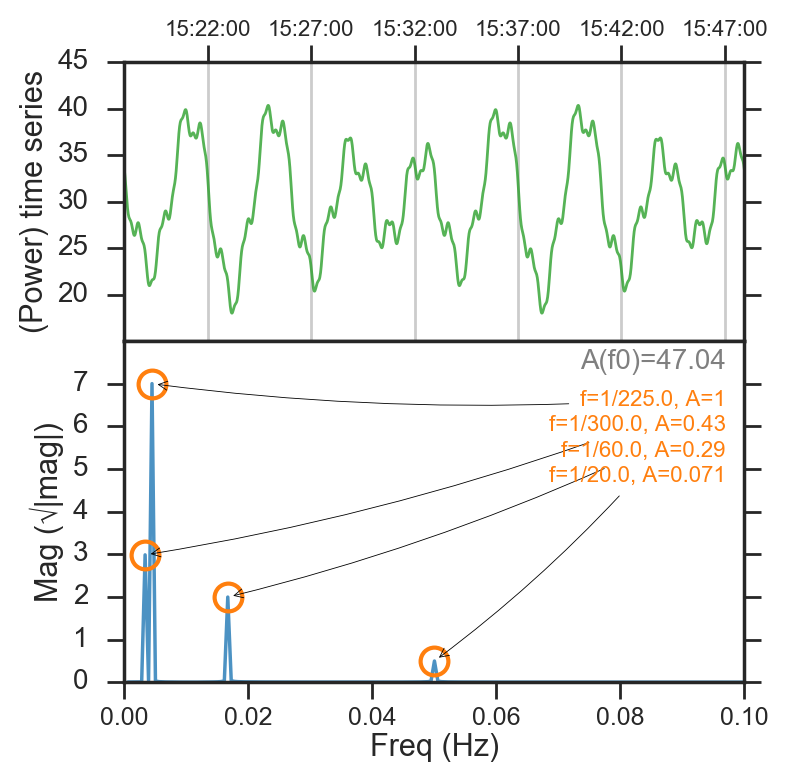

CALC FFT FEATURES TOOK: 0.619 s


In [1128]:
#autocorrelation_plot(df_i.power - df_i.power.mean()) 

sns.set_style('ticks')

def _gen_ts_sinusoidal(Ts=1, tf=3600, 
                       freqs=[1 / 300, 1 / 225, 1 / 60, 1/20], 
                       amps=[3, 7, 2, .5],
                       offsets=[3, 7, -5, .15], 
                       mean=30):
    N = tf // Ts
    tt = pd.DatetimeIndex(freq=pd.Timedelta(seconds=Ts), start=pd.Timestamp.now(tz=TZ).replace(microsecond=0), 
                          periods=N)
    t = np.linspace(0, tf, N)
    x = mean #+ np.random.random(N) * 0.3
    for a, f, o in zip(amps, freqs, offsets):
        x += a * np.cos(2*np.pi*f*t + o)
    return tt, x


def _plot_tt_fft(tt, x, df_fft, best_fft=None, log_mag=False, figsize=(8, 8)):
    # PLOT tt + fft
    fig, axes = plt.subplots(2, 1, figsize=figsize, 
                             gridspec_kw=dict(hspace=0, wspace=0, height_ratios=[.45, .55]))

    ax = axes[0]
    ax.xaxis.tick_top()
    ax.plot(tt, x, color=tableau20[4], lw=1, alpha=.8)
    ax.xaxis.set_major_formatter(mpd.DateFormatter('%H:%M:%S'))
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, ha='center')
    ax.xaxis.set_tick_params(labelsize=8, pad=2)
    # ax.set_xlabel('Time', labelpad=1)
    ax.set_ylabel('(Power) time series', labelpad=3)
    ax.grid('on', axis='x')
    ax.set_yticks(ax.get_yticks()[1:])

    # FFT plot
    ax = axes[1]
    ax.xaxis.tick_bottom()
    df_fft.mag.plot(ax=ax, color=tableau20[0], lw=1.25, alpha=.8, label='(Mag)')
    if best_fft is not None:
        for i, (f, row) in enumerate(best_fft.iterrows()):
            fr = row.frac_mag
            disp = 1 - fr
            ax.plot([f], [row.mag], 'o', markersize=10, markeredgewidth=1.5, markeredgecolor=tableau20[2], markerfacecolor=[0, 0, 0, 0])
            ax.annotate('f=1/{:.1f}, A={:.2g}'.format(row.cycles_f, row.frac_mag), (f, row.mag),
                        #xytext=(.75 + i * .05, row.frac_mag * .9), textcoords='axes fraction', 
                        xytext=(.97, .8 - i * .075), textcoords='axes fraction', 
                        ha='right', va='bottom', fontsize=8, color=tableau20[2], 
                        arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=-0.05"))
        ax.annotate('A(f0)={:.2f}'.format(np.sqrt(z_0) / best_fft.mag.iloc[0]), (.97, .92), xycoords='axes fraction', 
                    ha='right', fontsize=10, color=tableau20[14])
    ax.set_xlabel('Freq (Hz)', labelpad=1)
    #ax.set_xlim((0, max(.1, best_fft.index.max())))
    ax.set_xlim((0, min(.1, best_fft.index.max() * 10)))
    if log_mag:
        ax.set_ylabel('Mag (20·log10|mag|)', labelpad=3)
        ax.set_ylim((-60, ax.get_ylim()[1]))
    else:
        ax.set_ylabel('Mag (√|mag|)', labelpad=3)
    #ax.set_xlim((2/N, (1/Ts)/2))
    #ax.set_xlim((2/N, .5))
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, ha='center')
    ax.xaxis.set_tick_params(labelsize=9, pad=3)
    ax.set_yticks(ax.get_yticks()[:-1])
    #plt.show()
    return axes


@timeit('CALC FFT FEATURES', verbose=True)
def _feat_fft(tt, x, return_best=5, log_mag=False, plot=False, figsize=(8, 8), verbose=False):
    # Scipy Real FFT
    z_pure = 2 * scipy.fftpack.rfft(x) / len(x) # FFT
    y = scipy.fftpack.rfftfreq(len(x), d=(tt[1] - tt[0]).total_seconds()) # Frequency data
    #idx = np.argsort(y)
    #idx_mag = np.argsort(z)[::-1]
    
    # With pandas
    z_0 = z_pure[0]
    df = pd.DataFrame([z_pure[1:]**2, y[1:]], index=['mag', 'freq']).T.abs()
    if log_mag:
        df_fft = df.groupby('freq').sum().apply(lambda x: 20*np.log10(x))
        df_fft['frac_mag'] = (df_fft['mag'] / df_fft['mag'].max()).apply(lambda x: np.exp(x/20))
    else:
        df_fft = df.groupby('freq').sum().apply(np.sqrt)
        df_fft['frac_mag'] = df_fft['mag'] / df_fft['mag'].max()
    df_fft['cycles_f'] = [1/x for x in df_fft.index]

    if verbose:
        print(len(z_pure), sum(z_pure), sum(z_pure**2))
        print_red(df_fft.sort_values(by='mag', ascending=False).head())
    
    if log_mag:
        best_fft = df_fft.sort_values(by='mag', ascending=False).head(return_best)
    else:
        best_fft = df_fft[df_fft.frac_mag > .05].sort_values(by='mag', ascending=False).head(return_best)

    if plot:
        axes = _plot_tt_fft(tt, x, df_fft, best_fft, log_mag=log_mag, figsize=figsize)
        plt.show()
    return best_fft


#_feat_fft(*_gen_ts_sinusoidal(amps=[3, 7, 2, .5]), plot=True, figsize=(4, 4));
_feat_fft(*_gen_ts_sinusoidal(amps=[3, 7, 2, .5], tf=36000), plot=True, figsize=(4, 4));
_feat_fft(*_gen_ts_sinusoidal(amps=[3, 7, 2, .5], tf=1800), plot=True, figsize=(4, 4));

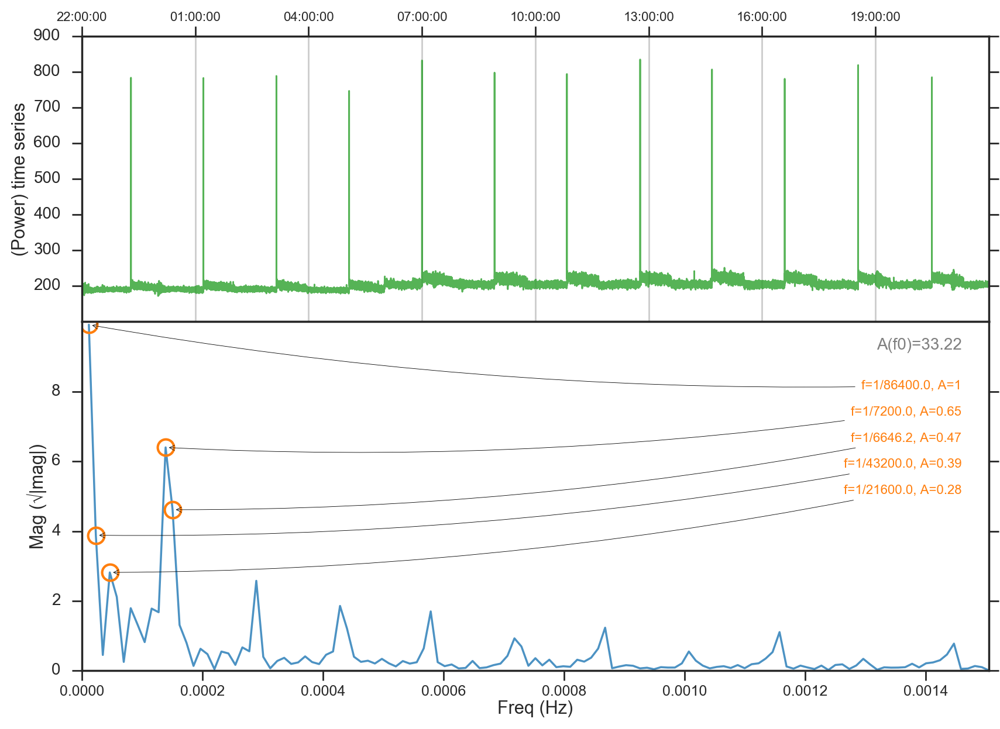

CALC FFT FEATURES TOOK: 3.843 s


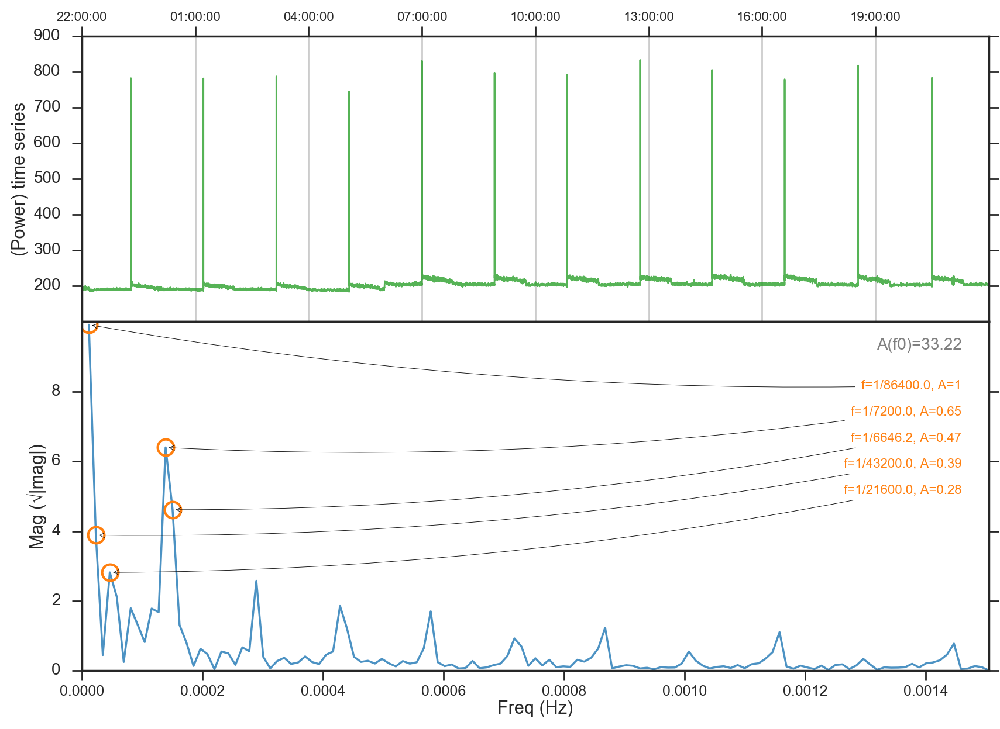

CALC FFT FEATURES TOOK: 5.027 s


In [1130]:
power_standby
#df1 = _feat_fft(power_standby.index, power_standby.power, plot=True, log_mag=True, figsize=(10, 7))
df1 = _feat_fft(power_standby.index, power_standby.power, plot=True, log_mag=False, figsize=(10, 7))
df2 = _feat_fft(power_standby.index, power_standby.wiener, plot=True, log_mag=False, figsize=(10, 7))


In [1319]:
@timeit('slice_window_fft', verbose=True)
def _slice_window_fft(data, size_w, frac_solape=.5, only_complete=True):
    
    def _feat_fft_fast(tt, x, with_freq=True):
        # Scipy Real FFT
        z_pure = scipy.fftpack.rfft(x) / len(x)
        mags = np.sqrt(z_pure[1:-1:2]**2 + z_pure[2:-1:2]**2)
        if with_freq:
            y = scipy.fftpack.rfftfreq(len(x), d=(tt[1] - tt[0]).total_seconds()) # Frequency data
            freqs = y[1:-1:2]
            return freqs, mags
        return mags
    
    N = len(data)
    start = data.index[0]
    end = data.index[-1]
    T = end - start
    Ts = data.index[1] - start
    delta = (1 - frac_solape) * size_w * Ts
    n = (T - size_w * Ts) / delta + 1
    results, freqs, init = [], None, False
    while start < end:
        data_w = data.loc[start:start + size_w * Ts - Ts]
        #print(data_w.tail(2))
        if only_complete and (data_w.shape[0] == size_w):
            if not init:
                freqs, mags = _feat_fft_fast(data_w.index, data_w.power, with_freq=True)
                init = True
            else:
                mags = _feat_fft_fast(data_w.index, data_w.power, with_freq=False)
            results.append((start, mags))
        #else:
        #    break
        start += delta
    #return pd.DataFrame(results)
    return freqs, results

    
# %timeit _slice_window_fft(power_standby, 14400, frac_solape=.75)
# 100 loops, best of 3: 10.4 ms per loop

def fft_window_power(power, delta='3h', step='15min'):
    window_delta = pd.Timedelta(delta)
    window_step = pd.Timedelta(step)
    fr_s = 1 - window_step / window_delta
    window_size = window_delta / power.index.freq
    print_cyan('Window size: {:.0f}, step: {}, (solape={:.3f})'.format(window_size, window_step, fr_s))
    freqs, results = _slice_window_fft(power, window_size, fr_s)
    return pd.DataFrame([pd.Series(data=r[1], index=freqs, name=r[0]) for r in results]).T #freqs, results

df_results = fft_window_power(power_standby, delta='3h', step='10min')
df_results_2 = fft_window_power(power_day14, delta='3h', step='10min')
df_results_3 = fft_window_power(power_day13, delta='3h', step='10min')
#fft_slice = 
#fft_slice

Window size: 10800, step: 0 days 00:10:00, (solape=0.944)
slice_window_fft TOOK: 0.075 s
Window size: 10800, step: 0 days 00:10:00, (solape=0.944)
slice_window_fft TOOK: 0.065 s
Window size: 10800, step: 0 days 00:10:00, (solape=0.944)
slice_window_fft TOOK: 0.060 s


In [1321]:
# FFT POWER

results_FFT = fft_window_power(POWER_FILT_2, delta='10min', step='5min')
print_ok(results_FFT.shape)
#results_FFT

Window size: 600, step: 0 days 00:05:00, (solape=0.500)
slice_window_fft TOOK: 4.892 s
(299, 12419)


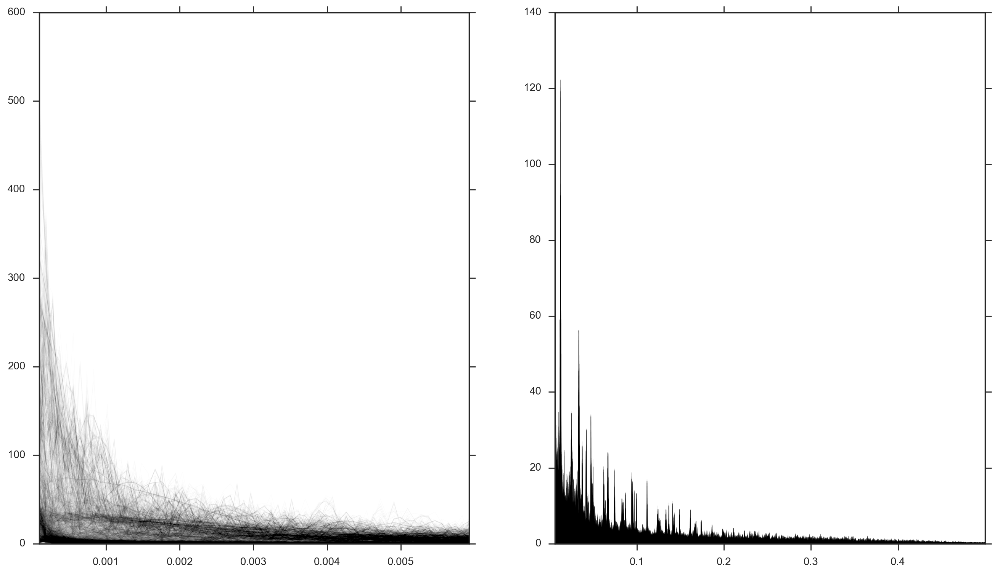

In [1292]:
plt.figure(figsize=(16, 9))
ax = plt.subplot(121)
results_FFT.loc[:.006].plot(ax=ax, lw=.5, color='k', alpha=.01)
plt.legend([])

ax = plt.subplot(122)
results_FFT.loc[.006:].plot(ax=ax, lw=.5, color='k', alpha=.1)
plt.legend([])

In [1296]:
results_FFT.loc[:.006].shape, results_FFT.loc[.006:].shape, results_FFT.loc[:.2].shape
#(results_FFT.loc[:.006] - results_FFT.loc[:.006].rolling(10).mean()) #.plot()

((64, 6193), (5335, 6193), (2160, 6193))

In [1329]:
from sklearn.cluster import KMeans, DBSCAN, AffinityPropagation, AgglomerativeClustering
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler


X = results_FFT.T.values
X_std = StandardScaler().fit_transform(X)

m_pca_1 = PCA(n_components=2, copy=True, whiten=True)
X_pca = m_pca_1.fit_transform(X)
m_pca_1

PCA(copy=True, n_components=2, whiten=True)

In [1332]:
len(X), len(X_pca), len(model_hd.labels_)

(12419, 12419, 24)

In [ ]:
m_pca_20 = PCA(n_components=20, copy=True, whiten=True)
X_pca20 = m_pca_20.fit_transform(X_std)
print(X_pca20.shape)


m_tsne_20 = TSNE(n_components=20)
X_tsne20 = m_tsne_20.fit_transform(X_std)
print(m_tsne_20.shape)

(12419, 20)


/Users/uge/Dropbox/PYTHON/PYPROJECTS/enerpi/enerpi/process_ldr.py:125: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 12419 but corresponding boolean dimension is 24
  ax.scatter(reduced_data[idx, 0], reduced_data[idx, 1], color='k', s=10, alpha=.7)
/Users/uge/anaconda/envs/py35/lib/python3.5/site-packages/sklearn/metrics/cluster/unsupervised.py:193: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 12419 but corresponding boolean dimension is 24
  a = np.mean(distances_row[mask])
/Users/uge/anaconda/envs/py35/lib/python3.5/site-packages/sklearn/metrics/cluster/unsupervised.py:219: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 12419 but corresponding boolean dimension is 24
  for cur_label in set(labels) if not cur_label == label])


For n_clusters = 3 The average silhouette_score is : -0.487292976993


/Users/uge/Dropbox/PYTHON/PYPROJECTS/enerpi/enerpi/process_ldr.py:87: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 12419 but corresponding boolean dimension is 24
  ax.plot(X[class_member_mask, 0], X[class_member_mask, 1], 'o', color=col, lw=0, markersize=size_scatter, alpha=.7)


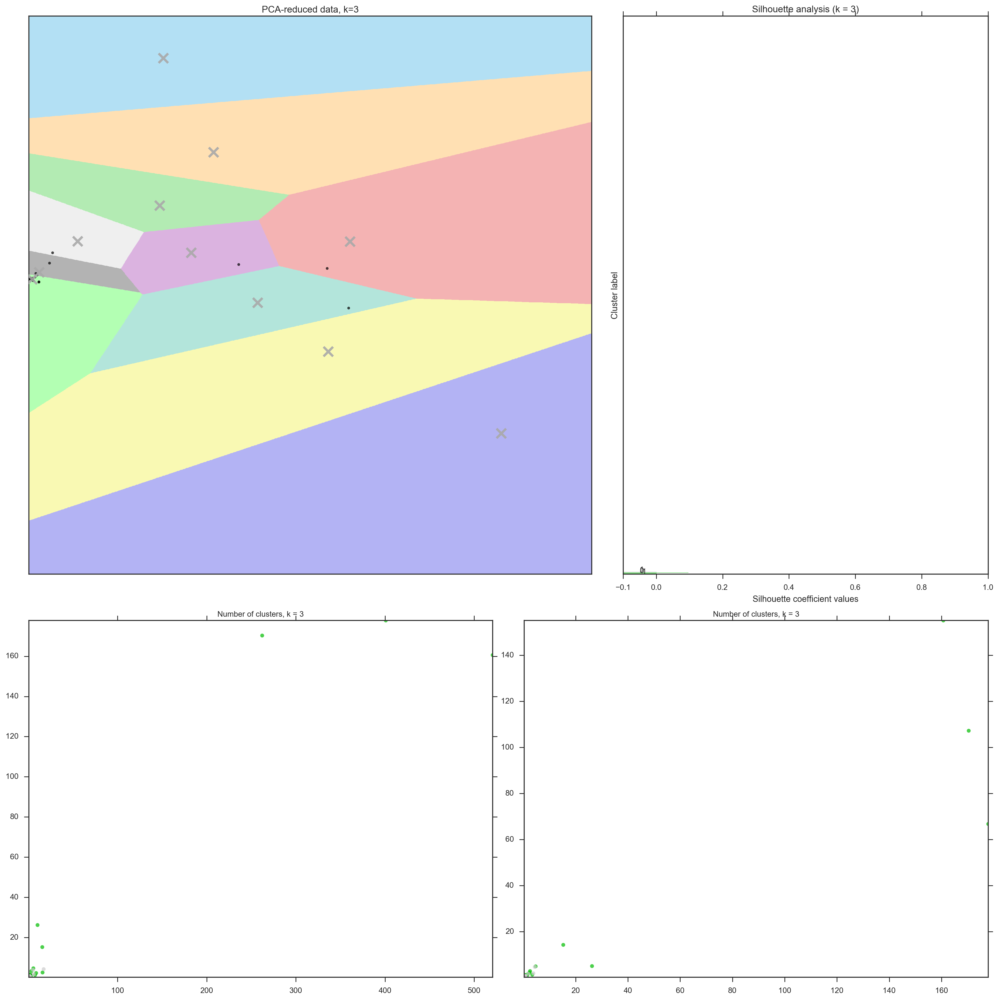

PLOT CLUSTERING TOOK: 9.343 s


In [1331]:
k = 11
#labels_pca, n_clusters_pca, model_pca, X_pca_2c = pca_clustering(X, k, whiten=True)
plot_clustering_figure(X, model_hd.labels_, plot_clustering_as_voronoi, X_pca, model_pca)



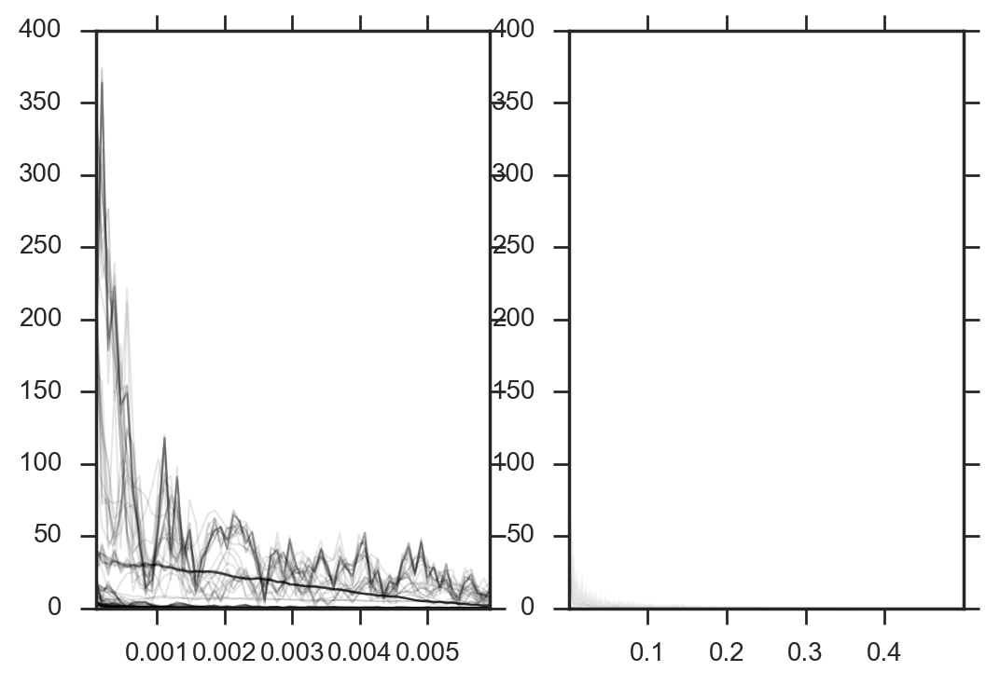

In [1287]:
ax = plt.subplot(121)
df_results_2.loc[:.006].plot(ax=ax, lw=.75, color='k', alpha=.1)
plt.legend([])

ax = plt.subplot(122)
df_results_2.plot(ax=ax, lw=.5, color='k', alpha=.005)
plt.legend([])

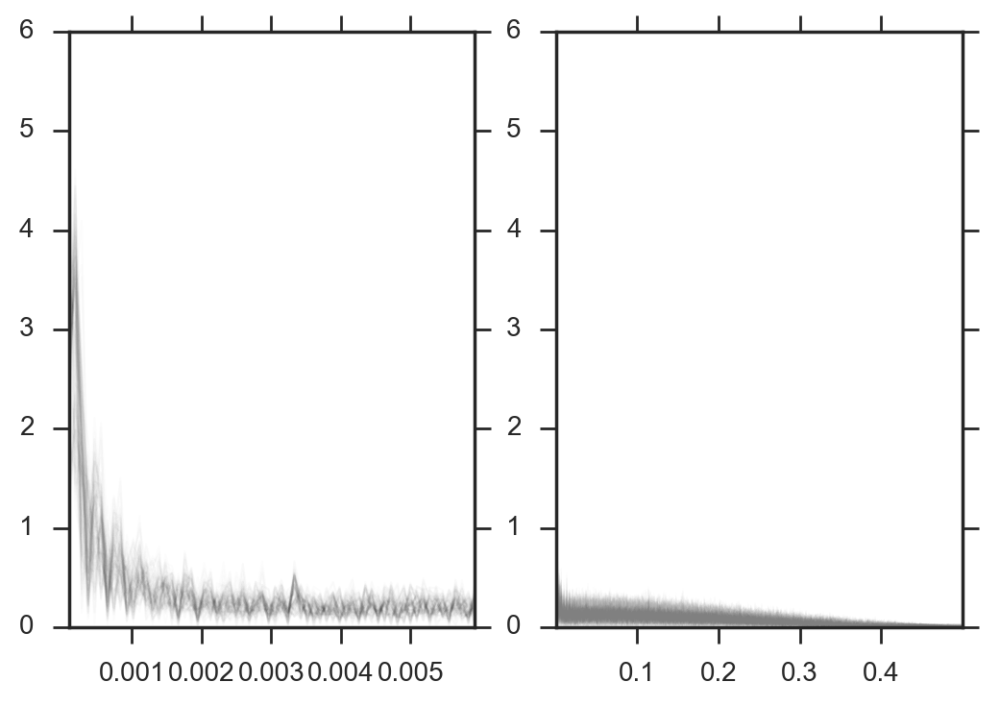

In [1270]:
#pd.DataFrame([pd.Series(data=r[1], index=[1/x for x in freqs], name=r[0]) for r in results]).T.plot(lw=.75)
#pd.DataFrame([pd.Series(data=r[1], index=freqs, name=r[0].time()) for r in results]).T.loc[:.06].plot(lw=.75, alpha=.3, legend='off')

ax = plt.subplot(121)
df_results.loc[:.006].plot(ax=ax, lw=.75, color='k', alpha=.01)
plt.legend([])

ax = plt.subplot(122)
df_results.plot(ax=ax, lw=.5, color='k', alpha=.005)
plt.legend([])


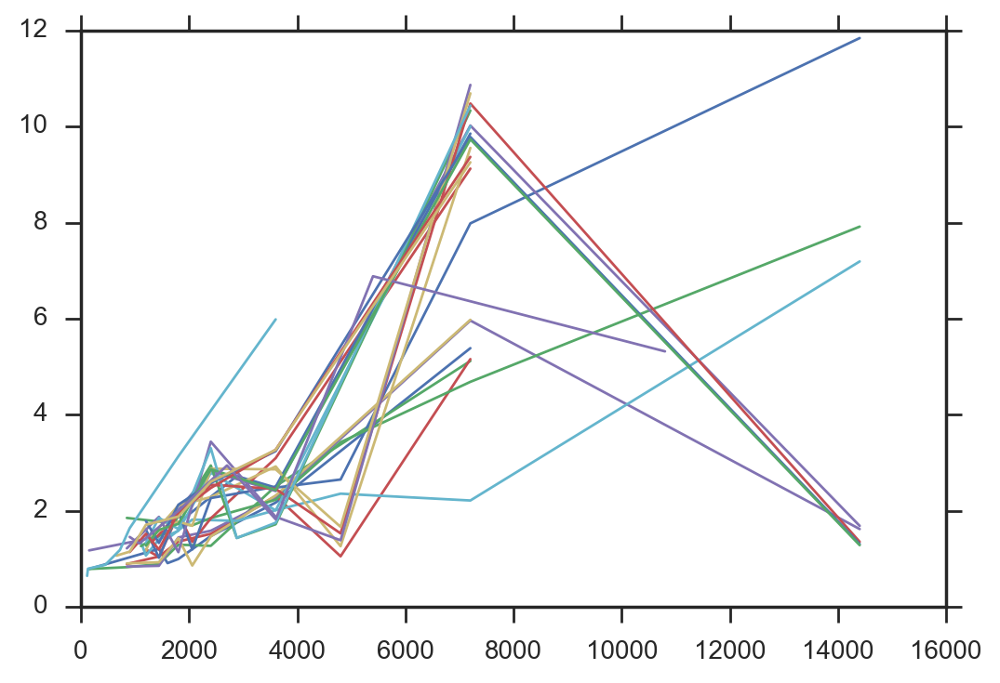

In [1132]:
ax = plt.subplot(111)
labels_c = ['c{:02d}'.format(i + 1) for i in range(7)]
labels_mag = ['mag{:02d}'.format(i + 1) for i in range(7)]
for id_w in fft_slice.index:
    ax.plot(fft_slice.loc[id_w].loc[labels_c], fft_slice.loc[id_w].loc[labels_mag], lw=1)
    

In [1133]:
pca_clustering(fft_slice.drop('start', axis=1), 3)

PCA Explained variance ratio: [ 0.94434091  0.03944973] --> 0.983790637749455
Estimated number of clusters: 3
Silhouette Coefficient: 0.899
                1  0  2
Label members  15  8  1


(array([1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1,
        2], dtype=int32),
 3,
 KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=3, n_init=10,
     n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
     verbose=0),
 array([[-2956.1641298 ,   425.55533299],
        [-3007.54185443,   654.04292741],
        [-2097.27840382, -1017.15072571],
        [ 5165.81056636,  1117.38085794],
        [-2877.16950807,    25.80630266],
        [ 5729.78799334,  -928.92545474],
        [ 5713.63386548,  -854.76767559],
        [ 5657.82575002,  -528.39466237],
        [-2863.30057696,   -81.11564305],
        [ 5138.42045138,  1328.54383895],
        [-2091.63497367, -1086.32240548],
        [-2947.73469331,   262.13073913],
        [-2863.30119502,   -81.11841383],
        [-2742.57946578,  -419.9339487 ],
        [ 5659.83283826,  -594.17079222],
        [-2097.28047211, -1017.16484652],
        [-2038.09173807, -1320.28410759],
        [

PCA Explained variance ratio: [ 0.94434091  0.03944973] --> 0.983790637749455
Estimated number of clusters: 5
Silhouette Coefficient: 0.838
               1  3  4  2  0
Label members  9  6  4  4  1
For n_clusters = 5 The average silhouette_score is : 0.467296424877


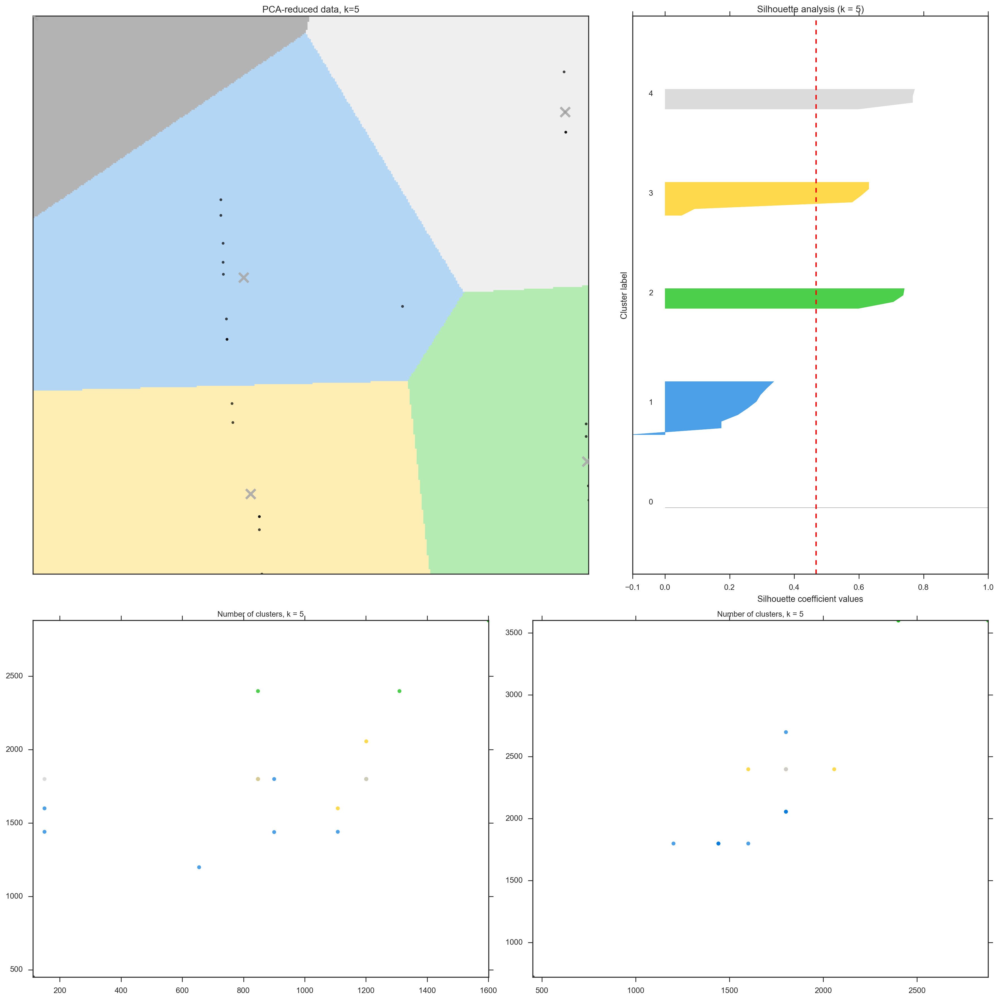

PLOT CLUSTERING TOOK: 4.769 s
For n_clusters = 3 The average silhouette_score is : 0.508488024416


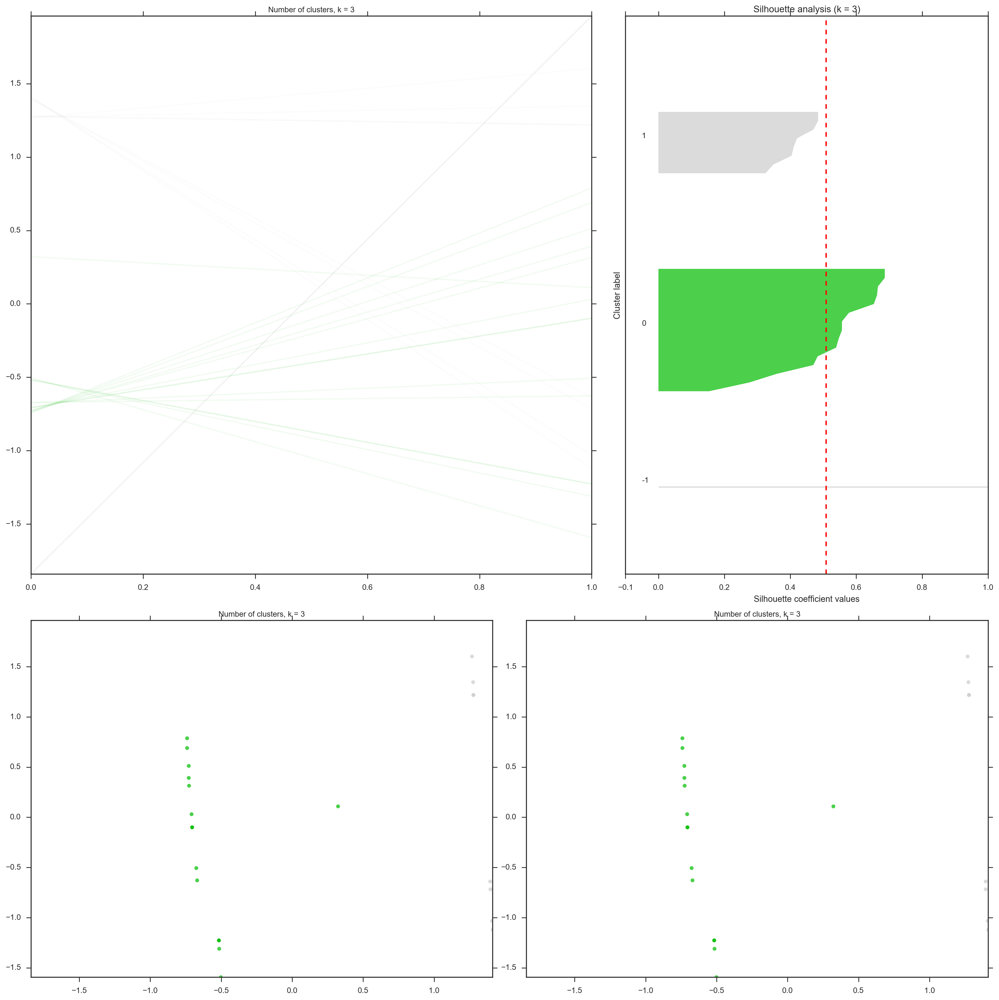

PLOT CLUSTERING TOOK: 4.965 s


In [1136]:
from hdbscan import HDBSCAN

X_features = fft_slice.drop('start', axis=1).values
k = 5
labels_pca, n_clusters_pca, model_pca, X_pca_2c = pca_clustering(X_features, k, whiten=True)
plot_clustering_figure(X_features, labels_pca, plot_clustering_as_voronoi, X_pca_2c, model_pca)

model_hd = HDBSCAN().fit(X_features)
plot_clustering_figure(X_pca_2c, model_hd.labels_, plot_clustering)


In [919]:
@timeit('local_maxima_minima', verbose=True)
def _local_max(serie, roll_w=3, verbose=False):

    def _is_local_max(x):
        #if np.max(x) == x[len(x) // 2]:
        if np.argmax(x) == len(x) // 2:
            return True
        return False

    if verbose:
        print_secc('LOCAL MAX de {} valores. Centered window of {} samples'
                   .format(len(serie), roll_w))
    maximos = serie.rolling(roll_w, center=True).apply(_is_local_max).fillna(0).astype(bool)
    if verbose:
        print_info(serie[maximos].head())
    return maximos


#cycles = [1/x for x in y]
#plt.scatter(cycles, z)
#plt.xlim(0, 310)
#cycles
#z[reversed(idx_mag)]
#np.argsort?

s = df_fft.mag
print_red(s.max())
maximos = _local_max(s, 7)

df_fft[maximos][s[maximos] / s.max() > .07]

112.190484733
local_maxima_minima TOOK: 0.004 s


,mag,cycles_f,frac_mag
freq,,,
0.003889,112.190485,257.142857,1.000000
0.013889,10.464811,72.000000,0.093277
0.016667,66.091980,60.000000,0.589105
0.018333,9.176115,54.545455,0.081790
0.020278,8.397489,49.315068,0.074850
0.048889,27.456626,20.454545,0.244732


996.766
553 20
239 40
227 59


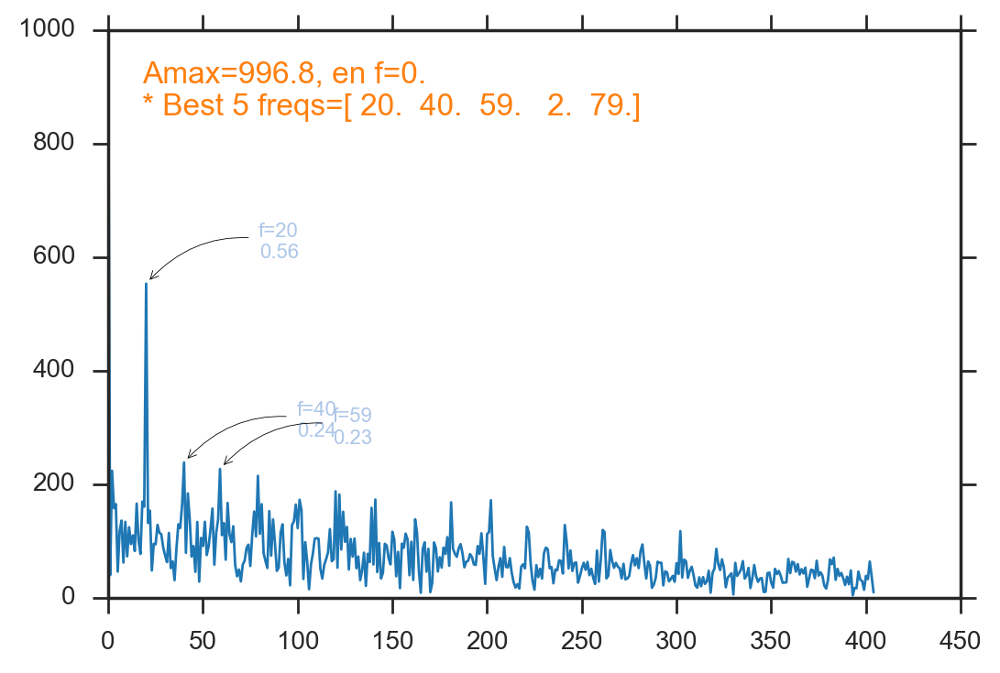

In [612]:
#abs_freqs = np.array(list(sorted(zip(fft_mag_i[1:], range(1, fft_mag_i.shape[0])), reverse=True)))
#abs_freqs.sort(axis=0)

#ax = _plot_row_evento(df_i)
ax = plt.subplot()
ax.plot(fft_mag_i, lw=1, color=tableau20[0])
max_abs, idx_max_abs = np.max(fft_mag_i), np.argmax(fft_mag_i)
for a, f in abs_freqs[:3,:]:
    ax.annotate('f={}\n{:.2f}'.format(int(f), a / max_abs), (f, a),
                xytext=(60, 10), textcoords='offset points', ha='right', fontsize=8, color=tableau20[1], 
                arrowprops=dict(arrowstyle="->",
                            connectionstyle="arc3,rad=0.3"))
ax.annotate('Amax={:.1f}, en f={:.0f}.\n* Best 5 freqs={}'.format(max_abs, idx_max_abs, abs_freqs[:5,1]), (.04, .85),
            xycoords='axes fraction', ha='left', fontsize=12, color=tableau20[2])

In [369]:
#df_feats_grupos_all_2[df_feats_grupos_all_2.duracion > 1000]
import sklearn.cluster as cluster
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from hdbscan import HDBSCAN

cols_cluster = ['deltas_sum', 'wiener_median', 'wiener_std', 'duracion', 'wiener_min', 'wiener_mean', 'wiener_max', 
                'eventos_sum', 'eventos_abs_sum', 'deltas_max', 'deltas_min', 'deltas_abs_sum']
df_X = df_feats_grupos_all_2[cols_cluster]
X = df_X.values
X_std = StandardScaler().fit_transform(X)

PCA Explained variance ratio: [ 0.98799845  0.00875039] --> 0.9967488392675097
Estimated number of clusters: 36
Silhouette Coefficient: 0.653
                 16   29   0    11   28   20  15  25  5   1  ...  4   27  12  17  6   2   7   26  33  22
Label members  1072  794  756  306  126  102  90  89  88  71 ...   3   2   2   2   2   2   1   1   1   1

[1 rows x 36 columns]
36
For n_clusters = 36 The average silhouette_score is : 0.0925662184395


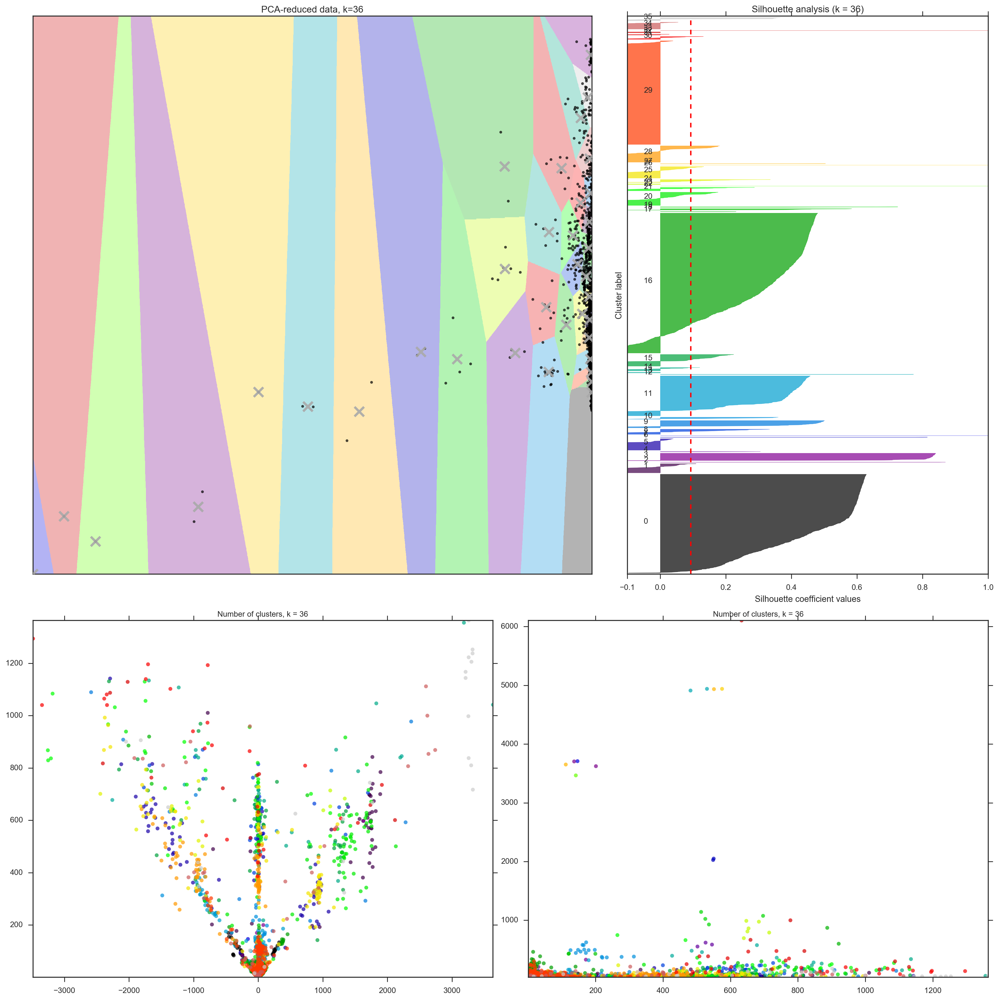

PLOT CLUSTERING TOOK: 13.193 s


In [366]:
from enerpi.process_ldr import pca_clustering, plot_clustering, plot_clustering_as_voronoi, plot_clustering_figure

k = 36
labels_pca, n_clusters_pca, model_pca, X_pca = pca_clustering(X, k, whiten=True, labels_true=None)
print(n_clusters_pca)

plot_clustering_figure(X, labels_pca, plot_clustering_as_voronoi, X_pca, model_pca)

60 clusters
 35    1406
-1      569
 22     344
 45     323
 18     199
dtype: int64
For n_clusters = 61 The average silhouette_score is : 0.214001019588


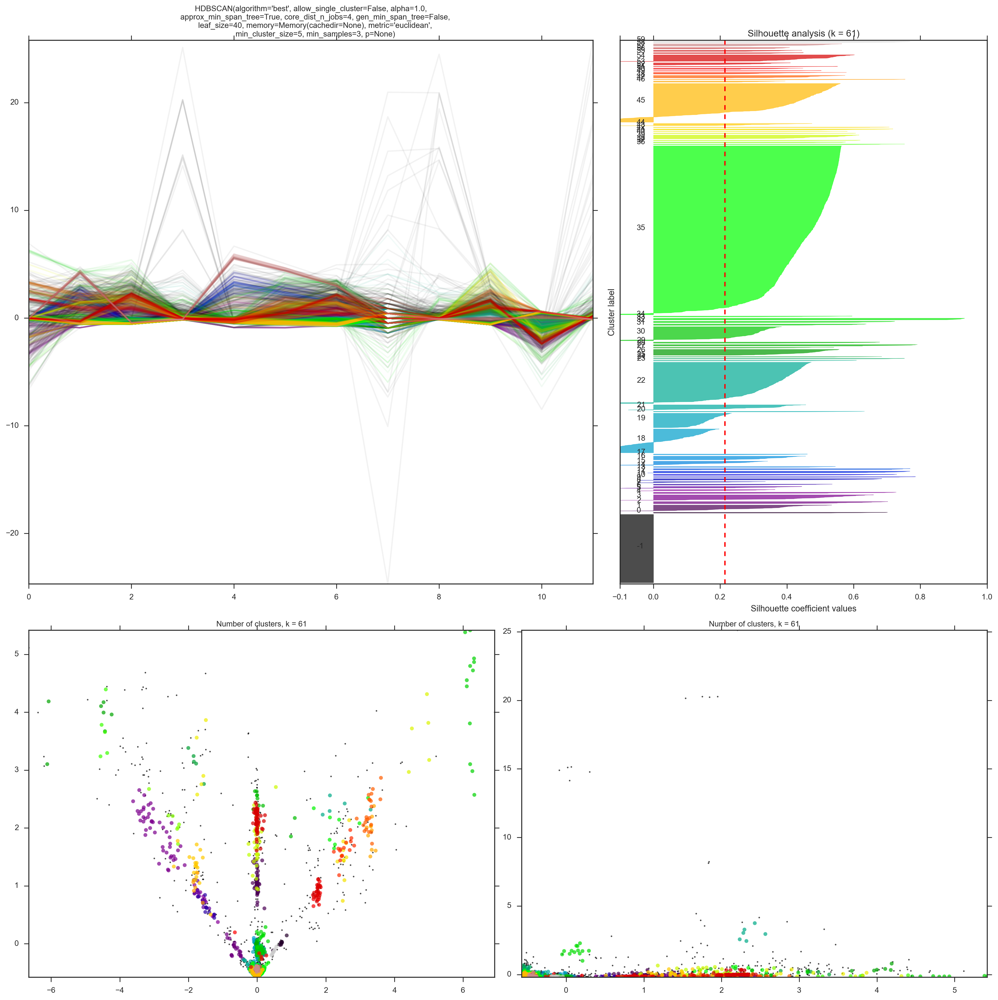

PLOT CLUSTERING TOOK: 22.389 s


In [375]:
model_hd = HDBSCAN(min_samples=3)
model_hd.fit(X_std)
vc = pd.Series(model_hd.labels_).value_counts()
print(len(vc) - 1, 'clusters')
print_info(vc.head())
plot_clustering_figure(X_std, model_hd.labels_, plot_clustering, model_hd)

In [377]:
df_feats_grupos_all_2

,t0,duracion,wiener_min,wiener_mean,wiener_max,wiener_std,wiener_median,eventos_sum,eventos_abs_sum,deltas_max,deltas_min,deltas_sum,deltas_abs_sum
index_ge,,,,,,,,,,,,,
0,2016-08-12 10:46:28+02:00,95,-1.000000,213.347885,331.670654,147.967381,311.287781,-1,15,271.602325,-303.736267,7.931885,710.998901
1,2016-08-12 10:52:58+02:00,70,-1.000000,184.577026,318.408142,154.389941,306.797699,-1,13,285.027222,-286.516541,1.574768,658.450684
2,2016-08-12 11:03:33+02:00,49,319.529663,366.452301,830.842773,95.759357,350.792023,-3,5,456.764282,-419.854736,30.661011,1078.235596
3,2016-08-12 11:48:39+02:00,63,336.026703,1653.730957,2285.592529,593.475410,2073.375000,0,8,519.634644,-161.533936,1741.777344,2305.727783
4,2016-08-12 11:49:43+02:00,126,315.759583,2057.140381,3449.008545,864.798098,1947.901733,2,24,811.942627,-1057.249023,-135.291748,8070.782715
5,2016-08-12 11:52:56+02:00,52,327.364227,699.996704,1953.853394,662.773528,340.282959,2,6,11.216675,-777.610291,-1589.116943,1695.518799
6,2016-08-12 13:16:49+02:00,42,318.791046,369.229706,843.292847,99.297872,346.718964,1,5,340.940002,-261.791412,25.908508,1078.473145
7,2016-08-12 14:07:03+02:00,66,384.219940,682.953674,1245.472046,386.372169,414.706238,0,10,519.228271,-350.620422,-7.729492,1905.845947
8,2016-08-12 14:09:07+02:00,48,375.858002,429.812012,869.665894,136.192613,379.317108,-1,5,241.166901,-199.529602,5.617523,1036.391113


In [380]:
POWER_FILT_2['intervalo'] = 0
POWER_FILT_2.loc[pd.DatetimeIndex(df_feats_grupos_all_2.t0), 'intervalo'] = 1
POWER_FILT_2['intervalo'] = POWER_FILT_2['intervalo'].cumsum()
POWER_FILT_2

,power,wiener,medfilt,deltas,eventos,intervalo
ts,,,,,,
2016-08-12 10:46:25+02:00,321.977661,308.650421,306.766022,0.000000,0,0
2016-08-12 10:46:26+02:00,321.467957,309.759857,306.766022,1.109436,0,0
2016-08-12 10:46:27+02:00,321.467957,310.723175,306.766022,0.963318,0,0
2016-08-12 10:46:28+02:00,312.116974,303.282471,306.766022,-7.440704,0,1
2016-08-12 10:46:29+02:00,306.766022,300.141235,310.393005,-3.141235,0,1
2016-08-12 10:46:30+02:00,310.393005,311.287781,311.656708,11.146545,1,1
2016-08-12 10:46:31+02:00,304.283630,310.553619,311.656708,-0.734161,-1,1
2016-08-12 10:46:32+02:00,297.700317,309.260498,310.393005,-1.293121,0,1
2016-08-12 10:46:33+02:00,300.129700,307.857758,307.243713,-1.402740,0,1


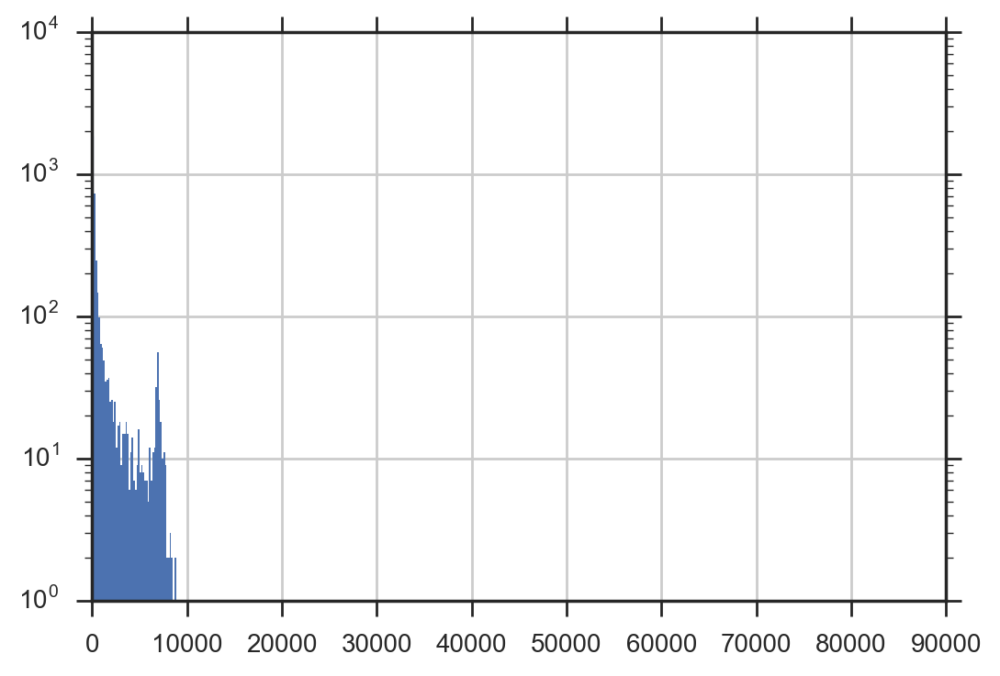

In [385]:
gb_int = POWER_FILT_2.groupby('intervalo')
gb_int.wiener.count().hist(log=True, bins=500, lw=0)

In [387]:
duracion_int = gb_int.wiener.count()
duracion_int[duracion_int > 10000]

intervalo
86      10510
2296    83331
2553    10861
Name: wiener, dtype: int64

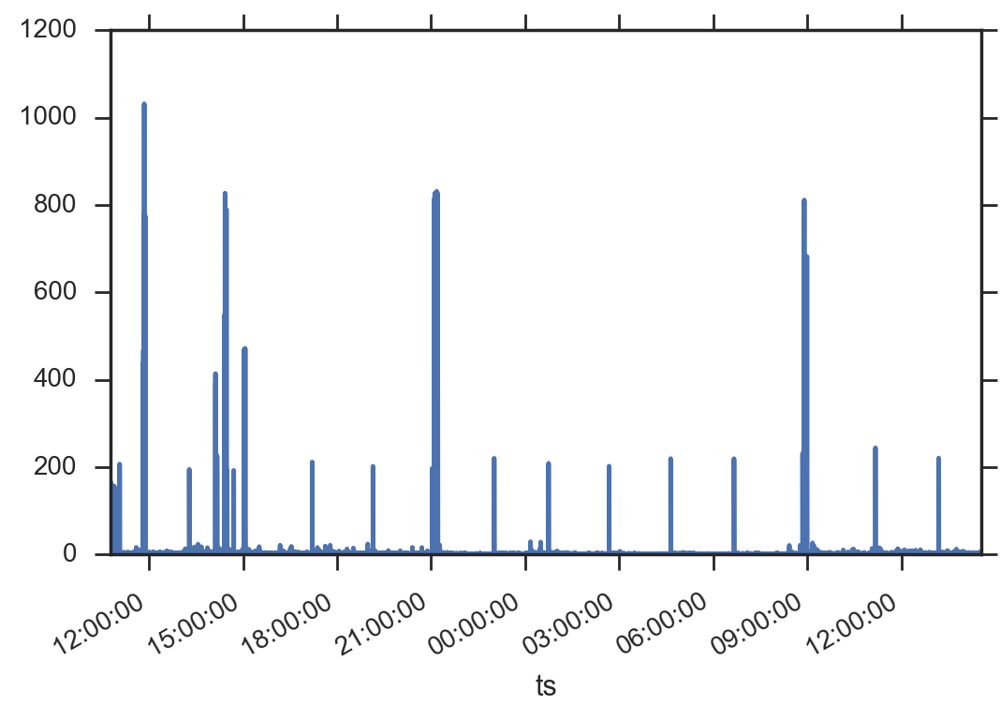

In [396]:
POWER_FILT_2.iloc[:100000].wiener.rolling(10).std().plot()

In [1]:
#POWER_FILT_2[POWER_FILT_2.intervalo == 2297]

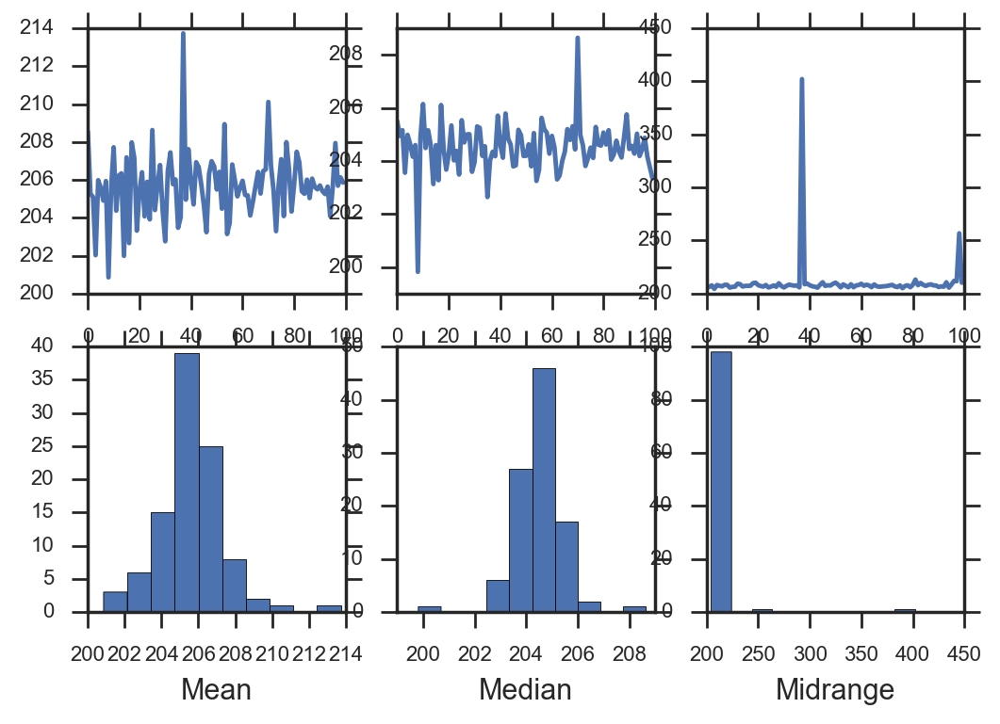

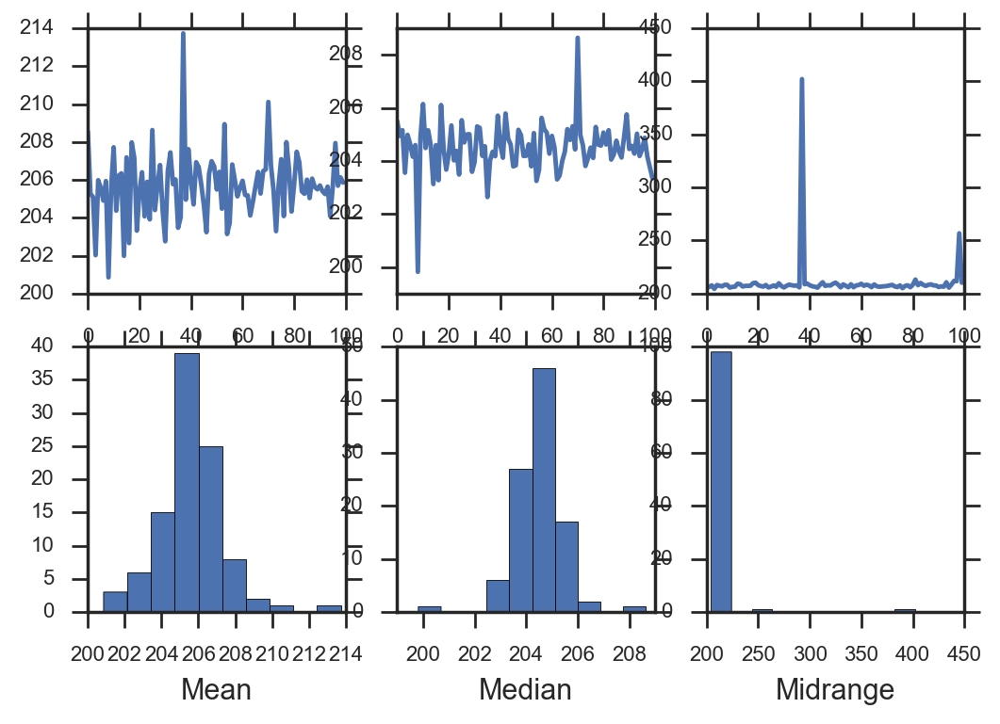

In [266]:
bootstrap_plot(df_power.wiener, samples=100)

In [250]:
#ax.add_patch?
mpp.Rectangle?

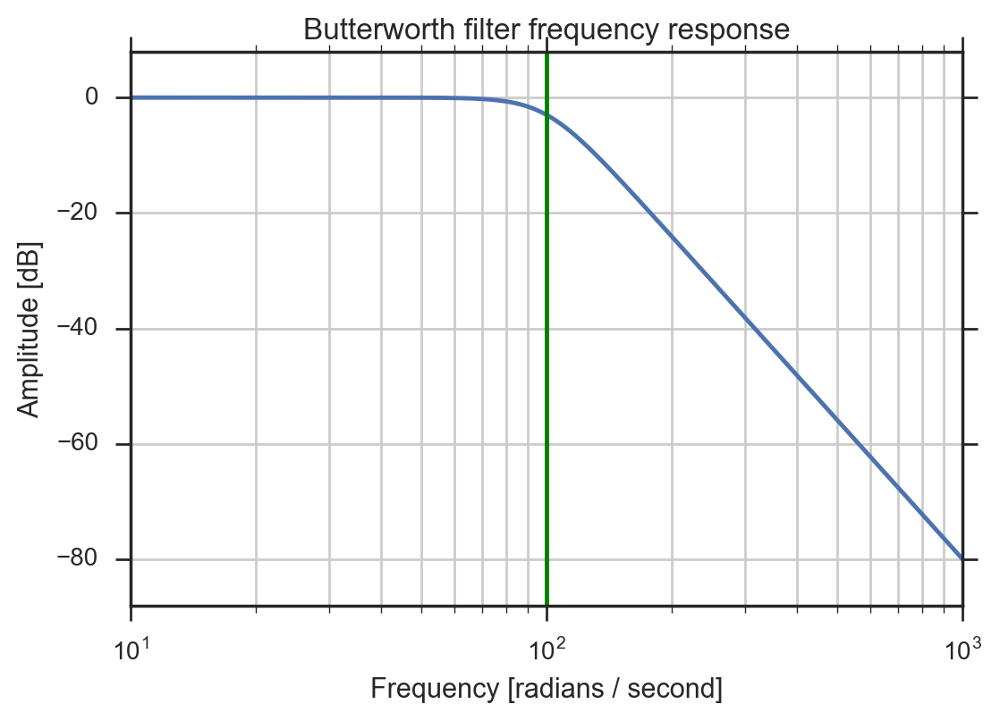

In [72]:
b, a = signal.butter(4, 100, 'low', analog=True)
w, h = signal.freqs(b, a)
plt.semilogx(w, 20 * np.log10(abs(h)))
plt.title('Butterworth filter frequency response')
plt.xlabel('Frequency [radians / second]')
plt.ylabel('Amplitude [dB]')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(100, color='green') # cutoff frequency
plt.show()

In [73]:
signal.butter?

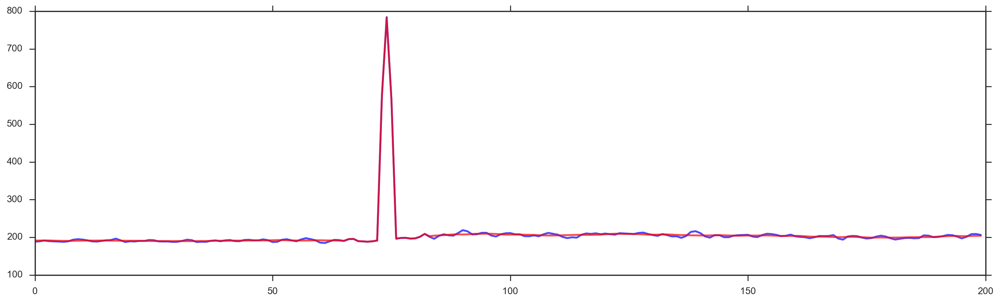

In [106]:
plt.figure(figsize=(18, 5))
t0, tf = 4600, 4800
plt.plot(power_standby.power.iloc[t0:tf].values, lw=2, alpha=.7, color='blue')
#plt.plot(signal.medfilt(power_standby.power, 3)[t0:tf], lw=1, alpha=.7, color='orange')
plt.plot(signal.wiener(power_standby.power, 15)[t0:tf], lw=2, alpha=.7, color='red')


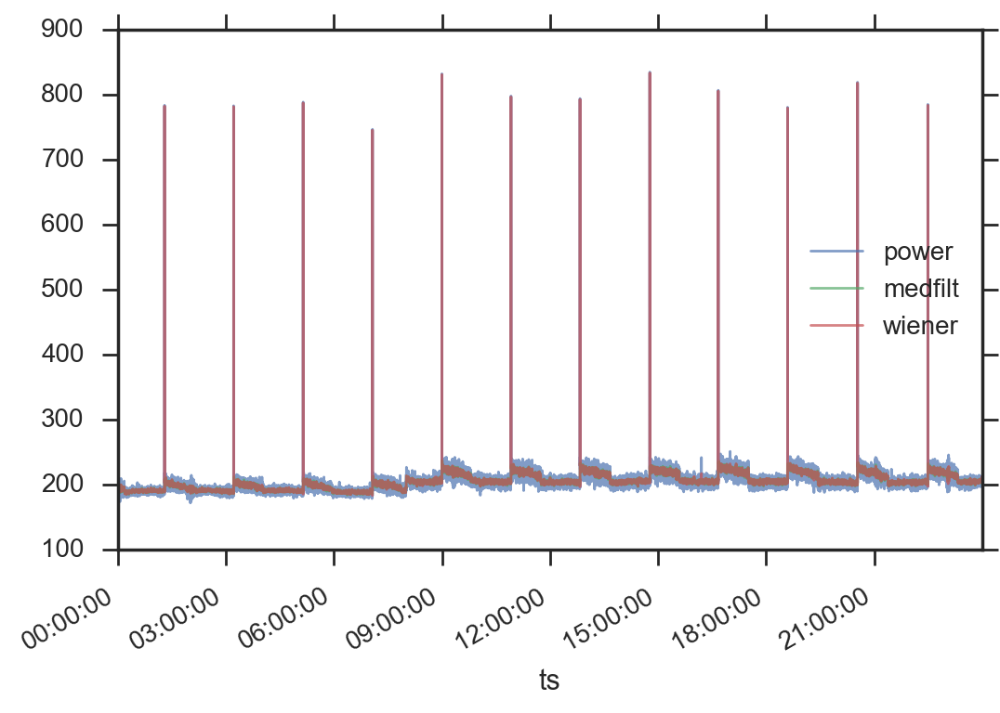

In [107]:
power_standby['medfilt'] = signal.medfilt(power_standby.power, 15)
power_standby['wiener'] = signal.wiener(power_standby.power, 15)
power_standby.plot(lw=1, alpha=.7)

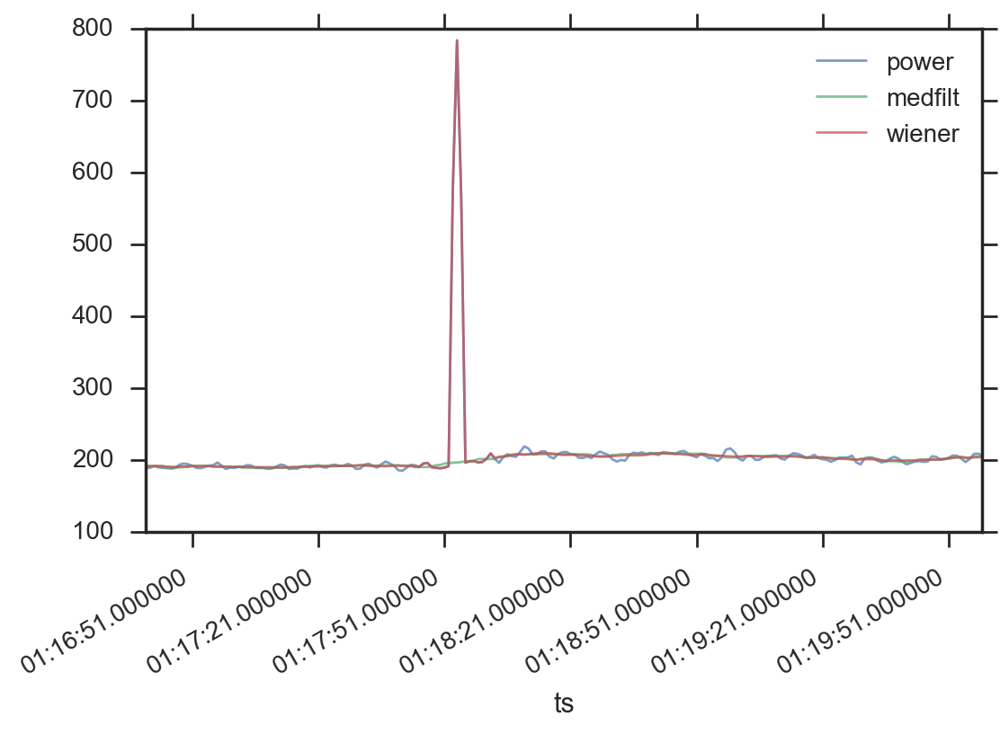

In [108]:
power_standby.iloc[t0:tf].plot(lw=1, alpha=.7)

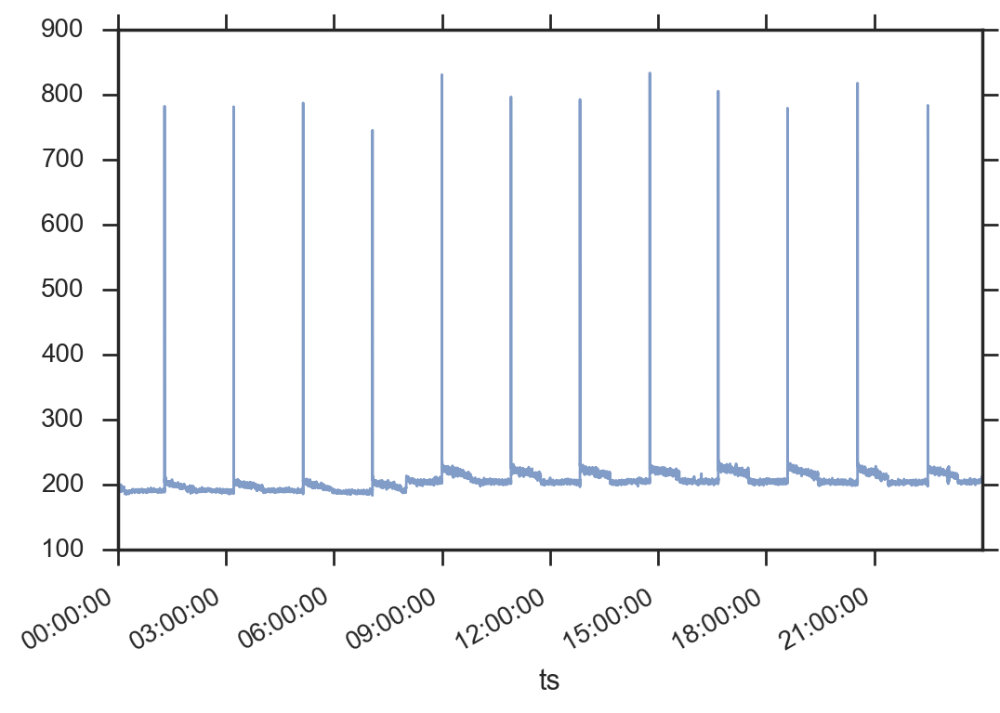

In [109]:
power_standby.wiener.plot(lw=1, alpha=.7)

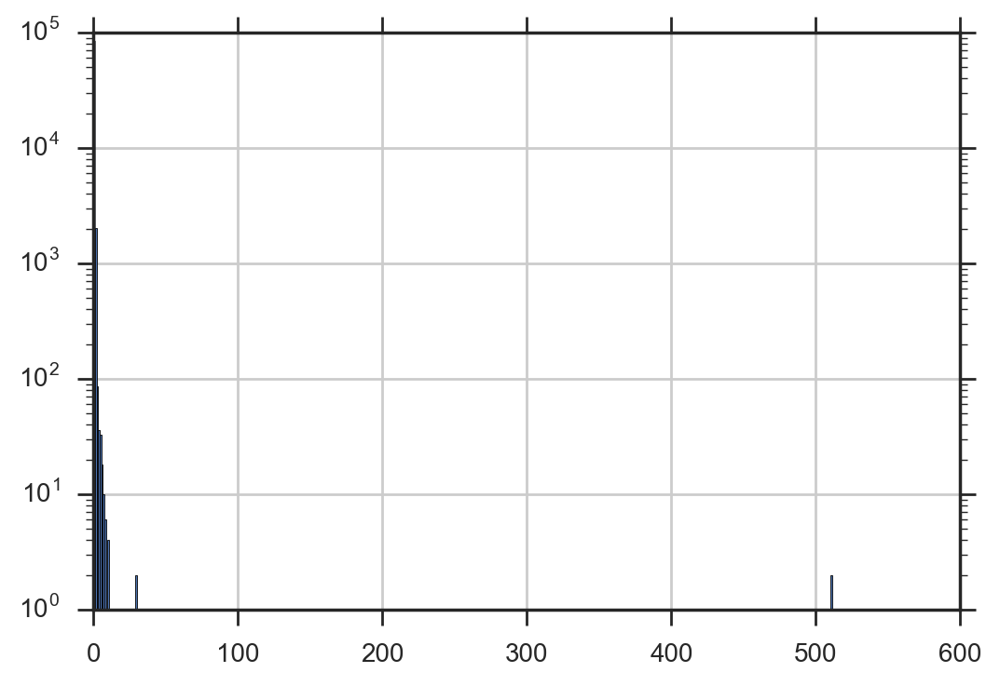

In [114]:
power_standby.wiener.diff().fillna(0).abs().hist(bins=500, log=True)

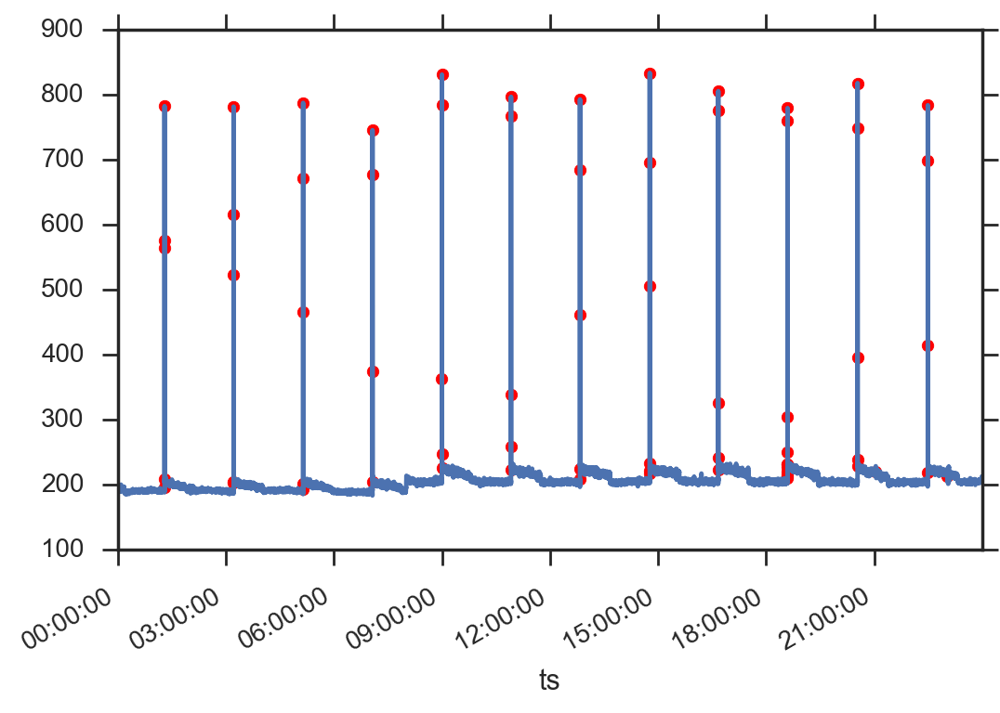

In [128]:
power_standby['event'] = False
power_standby.loc[power_standby.wiener.diff().fillna(0).abs() > 7, 'event'] = True
ax = power_standby.wiener.plot()
ax.scatter(power_standby[power_standby.event].index, power_standby[power_standby.event].wiener, color='red')

In [136]:
deltas = power_standby.diff().fillna(0)
deltas.wiener.rolling(3).mean() #apply(lambda x: np.cumsum(x))

ts
2016-08-29 00:00:00+02:00         NaN
2016-08-29 00:00:01+02:00         NaN
2016-08-29 00:00:02+02:00   -0.141764
2016-08-29 00:00:03+02:00    0.181305
2016-08-29 00:00:04+02:00   -0.288992
2016-08-29 00:00:05+02:00    2.168846
2016-08-29 00:00:06+02:00    2.571614
2016-08-29 00:00:07+02:00    1.198023
2016-08-29 00:00:08+02:00   -0.529463
2016-08-29 00:00:09+02:00   -1.175400
2016-08-29 00:00:10+02:00    0.407990
2016-08-29 00:00:11+02:00    0.529989
2016-08-29 00:00:12+02:00    0.489961
2016-08-29 00:00:13+02:00    0.182679
2016-08-29 00:00:14+02:00   -0.024249
2016-08-29 00:00:15+02:00   -0.037511
2016-08-29 00:00:16+02:00    0.094967
2016-08-29 00:00:17+02:00    0.303784
2016-08-29 00:00:18+02:00    0.341208
2016-08-29 00:00:19+02:00    0.203632
2016-08-29 00:00:20+02:00   -0.080285
2016-08-29 00:00:21+02:00   -0.389639
2016-08-29 00:00:22+02:00   -0.565366
2016-08-29 00:00:23+02:00   -0.469247
2016-08-29 00:00:24+02:00   -0.368773
2016-08-29 00:00:25+02:00   -0.536479
2016-08-2

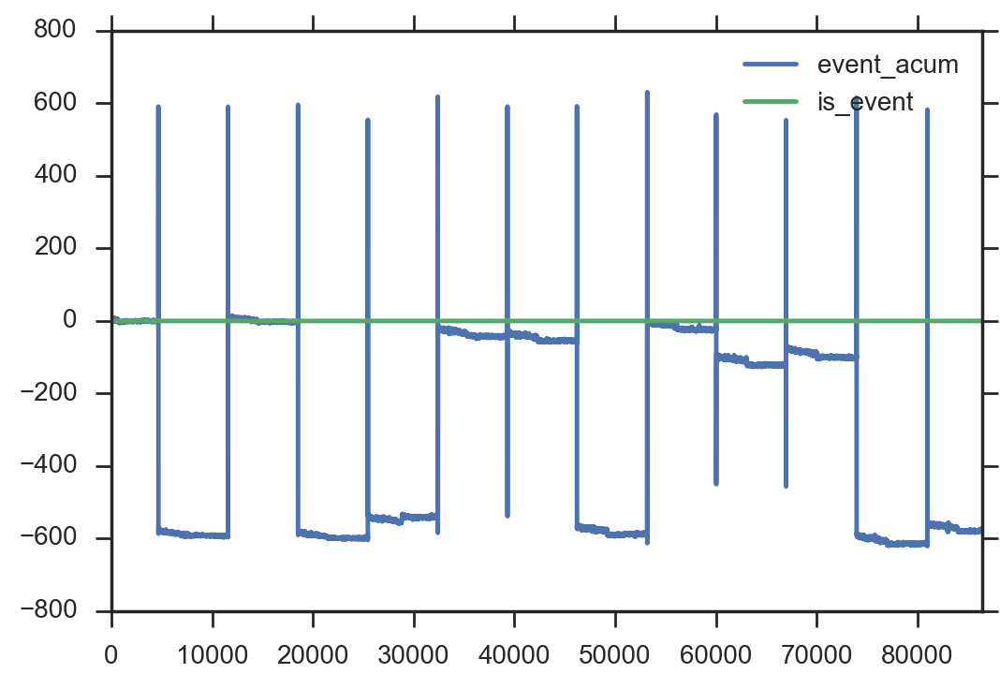

In [146]:
cumsum_event = 0
s_cumsum = []
s_event = []
for v in deltas.wiener:
    if abs(v) > 10 and not s_event[-1]:
        cumsum_event = v
        s_event.append(True)
    else:
        s_event.append(False)
        cumsum_event += v
    s_cumsum.append(cumsum_event)
pd.DataFrame([s_cumsum, s_event], index=['event_acum', 'is_event']).T.plot()

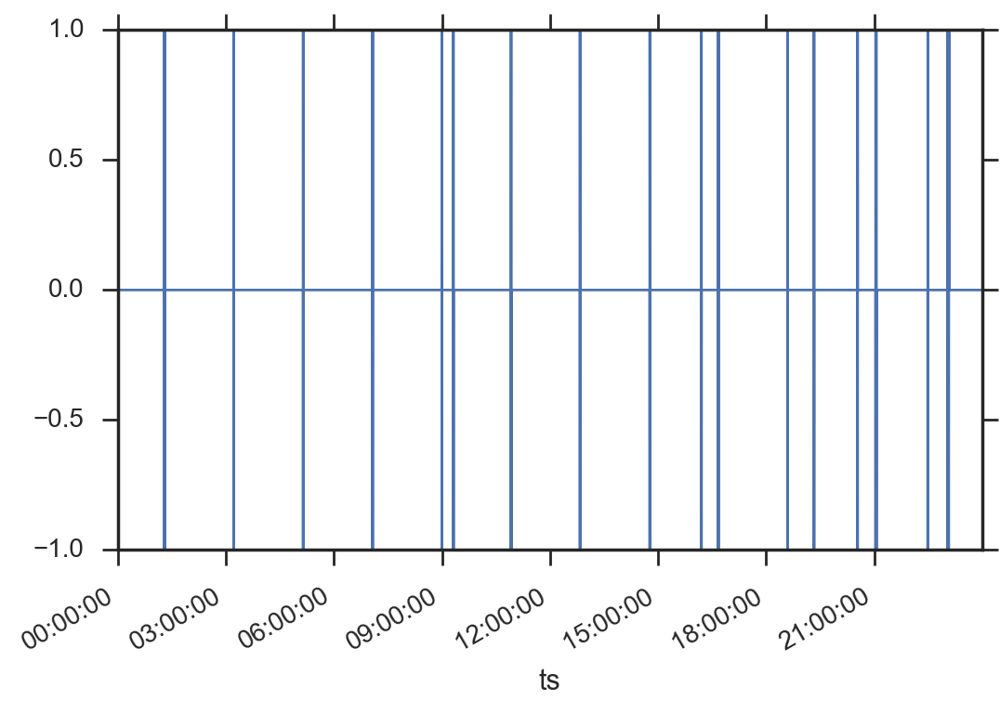

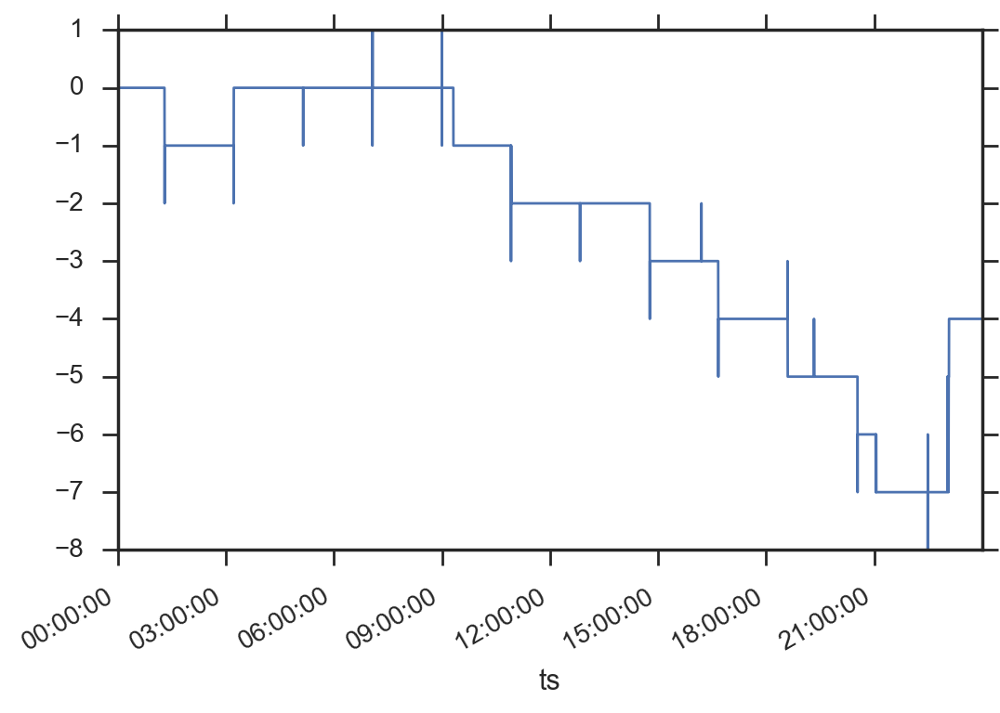

In [169]:
THRESHOLD_EVENT = 10

def _is_event(x):
    mid = len(x) // 2
    xmin = np.min(x)
    xmax = np.max(x)
    if ((xmax - xmin) > THRESHOLD_EVENT):
        if (x[mid] == xmin):
            return -1
        elif (x[mid] == xmax):
            return 1
    return 0


eventos = deltas.wiener.diff().fillna(0).rolling(9, center=True).apply(_is_event).fillna(0)
eventos.plot(lw=1)
plt.show()
eventos.cumsum().plot(lw=1)

(190, 250)

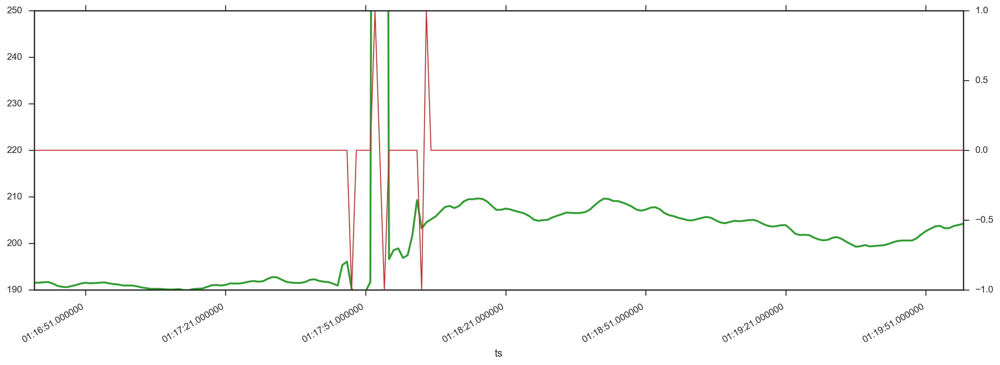

In [170]:
f, ax = plt.subplots(1, 1, figsize=(18, 6))
ax = power_standby.wiener.iloc[t0:tf].plot(lw=2, color=tableau20[4])
ax2 = plt.twinx(ax)
ax2 = eventos.iloc[t0:tf].plot(ax=ax2, lw=1, color=tableau20[6])
ax.set_ylim((190, 250))

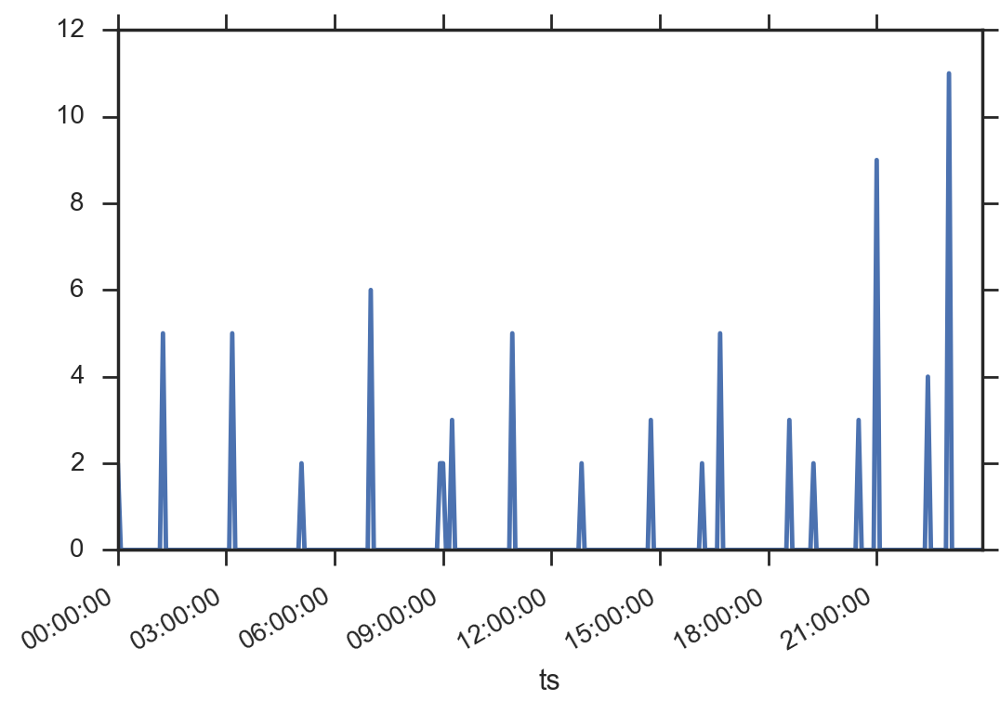

In [174]:
eventos.abs().resample('5min').sum().plot()

In [187]:
tt_ev = eventos[eventos != 0].index
tt_ev = pd.Index(tt_ev[1:].values - tt_ev[:-1].values)
tt_ev

TimedeltaIndex(['00:00:02', '01:17:41', '00:00:05', '00:00:02', '00:00:08', '00:00:01', '01:54:55', '00:00:02',
                '00:00:06', '00:00:01', '00:00:04', '01:55:37', '00:00:02', '01:55:21', '00:00:01', '00:00:05',
                '00:00:02', '00:00:07', '00:00:01', '01:55:25', '00:00:02', '00:00:06', '00:00:02', '00:18:57',
                '00:00:03', '00:00:02', '01:35:58', '00:00:06', '00:00:02', '00:00:06', '00:00:01', '01:54:47',
                '00:00:02', '01:56:09', '00:00:06', '00:00:02', '01:25:54', '00:00:02', '00:27:56', '00:00:07',
                '00:00:02', '00:00:05', '00:00:02', '01:55:18', '00:00:02', '00:00:07', '00:43:58', '00:00:01',
                '01:12:25', '00:00:06', '00:00:02', '00:30:09', '00:00:04', '00:00:06', '00:00:01', '00:00:04',
                '00:00:02', '00:00:36', '00:00:03', '00:00:04', '01:25:47', '00:00:01', '00:00:06', '00:00:02',
                '00:32:32', '00:00:05', '00:00:01', '00:01:18', '00:00:05', '00:00:25', '00:00:01', '00:

In [205]:
deltas = power_standby.diff().fillna(0)

#pd.Index(tt_ev[1:].values - tt_ev[:-1].values)
#tt_ev
margin_td = pd.Timedelta('120s')

t0 = eventos.index[0]
list_index_events = []
last_event_init = None
events_in_interval = []
for t in eventos[eventos != 0].index:
    if last_event_init is None:
        last_event_init = t
        events_in_interval.append(t)
    elif t > last_event_init + margin_td:
        list_index_events.append(events_in_interval)
        events_in_interval = [t]
        last_event_init = t
    else:
        events_in_interval.append(t)
        last_event_init = t
    
len(list_index_events), list_index_events

sub_events = []
margin_ant = pd.Timedelta('5s')
cols = ['power', 'medfilt', 'wiener']
for ts in list_index_events:
    print_red(ts)
    t0, tf = ts[0] - margin_ant, ts[-1] + margin_td
    
    d_i = deltas.loc[t0:tf, cols].rename(columns)
    p_i = power_standby.loc[t0:tf, cols]
    sec_i = eventos.loc[t0:tf]
    print_cyan(d_i)
    print_info(p_i)
    print_yellow(sec_i)
    break
        

[Timestamp('2016-08-29 00:00:05+0200', tz='Europe/Madrid'), Timestamp('2016-08-29 00:00:07+0200', tz='Europe/Madrid')]
                               power   medfilt    wiener  event
ts                                                             
2016-08-29 00:00:00+02:00   0.000000  0.000000  0.000000      0
2016-08-29 00:00:01+02:00   1.601990  0.624222  1.692263  False
2016-08-29 00:00:02+02:00  -2.226212  0.283005 -2.117555  False
2016-08-29 00:00:03+02:00   0.907227  0.215881  0.969206  False
2016-08-29 00:00:04+02:00   0.215881  1.103104  0.281374  False
2016-08-29 00:00:05+02:00   5.296326  2.875626  5.255960  False
2016-08-29 00:00:06+02:00   2.266464  0.000000  2.177510  False
2016-08-29 00:00:07+02:00  -2.914139  0.000000 -3.839400  False
2016-08-29 00:00:08+02:00   0.623169  0.000000  0.073502  False
2016-08-29 00:00:09+02:00  -1.234161  0.058929  0.239698  False
2016-08-29 00:00:10+02:00  -0.058929  0.610992  0.910770  False
2016-08-29 00:00:11+02:00   2.503052  0.049927  0